<h2 align=center>Generate Synthetic Images with DCGANs in Keras</h2>

## Task 1: Project Overview and Import Libraries

In [318]:
%matplotlib inline
# import tensorflow as tf
# from tensorflow import keras
import numpy as np
import plot_utils
import matplotlib.pyplot as plt
from tqdm import tqdm
from IPython import display
import torch
from torch import nn
import torchvision
from torchvision import transforms
from torchvision.datasets import FashionMNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader

## Task 2: Load and Preprocess the Data

In [319]:
# (x_train,y_train),(x_test,y_test)=keras.datasets.fashion_mnist.load_data()
# x_train=x_train.astype(np.float32)/255.0
# x_test=x_test.astype(np.float32)/255.0
# batch_size = 32



In [320]:
# plt.figure(figsize=(10,10))
# for i in range(25):
#     plt.subplot(5,5,i+1)
#     plt.xticks([])
#     plt.yticks([])
#     plt.grid(False)
#     plt.imshow(x_train[i],cmap=plt.cm.binary)
# plt.show()    

In [321]:
batch_size=32
ransform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataset = FashionMNIST('.', download=True, transform=transform)
print(len(dataset))

60000


In [322]:
# Create torch Datasets

train_dataset,test_dataset=torch.utils.data.random_split(dataset, [30000, 30000 ])
# Create DataLoaders for the Datasets
train_dataloader = DataLoader(
    train_dataset, batch_size=batch_size, shuffle=True
)
test_dataloader = DataLoader(
    test_dataset, batch_size=batch_size, shuffle=False
)
print(len(train_dataset))

30000


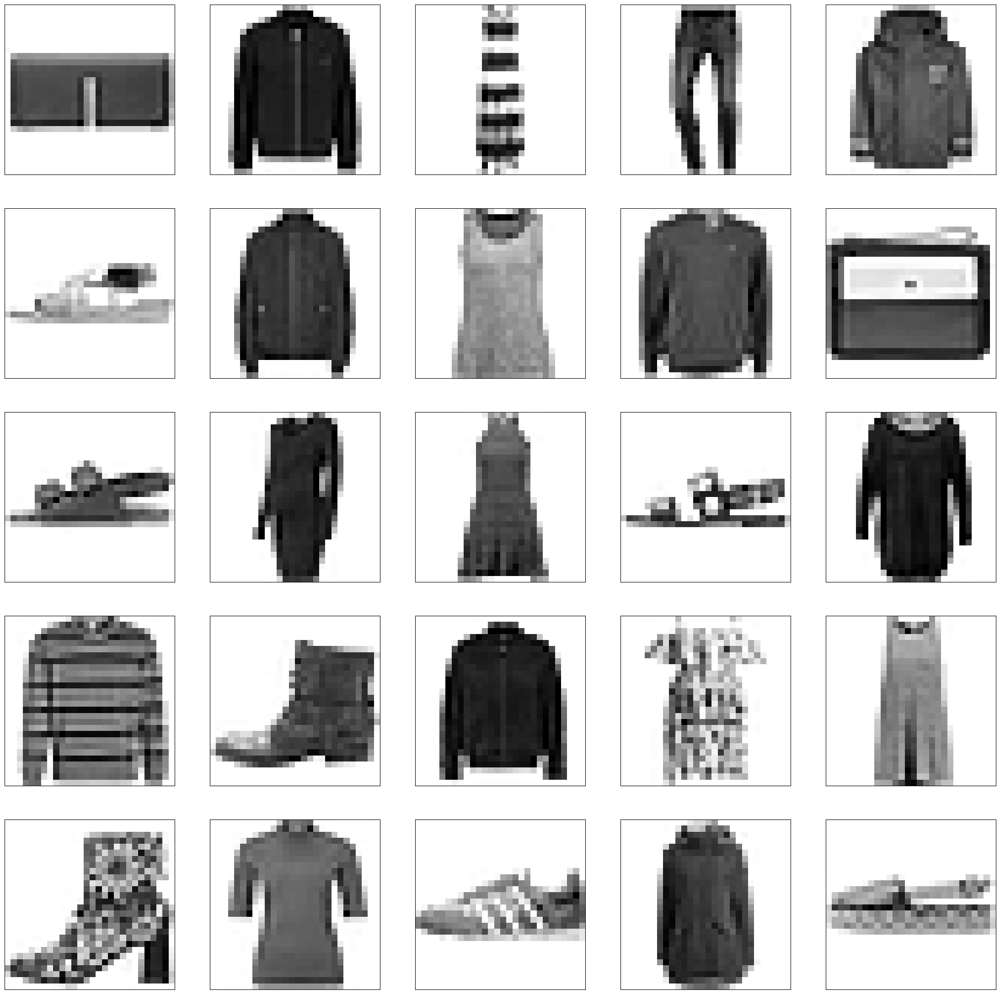

In [323]:
plt.figure(figsize=(28,28))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(train_dataset[i][0].squeeze(),cmap=plt.cm.binary)
plt.show()    

## Task 3: Create Batches of Training Data

In [324]:
# dataset=tf.data.Dataset.from_tensor_slices(x_train).shuffle(1000)
# dataset=dataset.batch(batch_size,drop_remainder=True).prefetch(1)


## Task 4: Build the Generator Network for DCGAN

![GAN](DCGAN.png)

**Generator** is an upsampling network with fractionally-strided convolutions

**Discriminator** is a convolutional network

Architecture guidelines for stable Deep Convolutional GANs:

- Replace any pooling layers with strided convolutions (discriminator) and fractional-strided convolutions (generator).
- Use batchnorm in both the generator and the discriminator.
- Remove fully connected hidden layers for deeper architectures.
- Use ReLU activation in generator for all layers expect for the output, which uses Tanh.
- Use LeakyReLU activation in the discriminator for all layers.

[Source](https://arxiv.org/pdf/1511.06434.pdf): Radford et al, "*Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks*", ICLR 2016

In [325]:
#num_features=100
# generator=keras.models.Sequential([
#     keras.layers.Dense(7*7*128,input_shape=[num_features]),
#     keras.layers.Reshape([7,7,128]),
#     keras.layers.BatchNormalization(),
#     keras.layers.Conv2DTranspose(64,(5,5),(2,2),padding="same",activation="selu"),
#     keras.layers.BatchNormalization(),
#     keras.layers.Conv2DTranspose(1,(5,5),(2,2),padding="same",activation="tanh")
# ])


In [326]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (Fashion_MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=100, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2,final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN, 
        corresponding to a transposed convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''


        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU()
            )
        else: # Final Layer
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh()
            )

    def unsqueeze_noise(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns a copy of that noise with width and height = 1 and channels = z_dim.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return noise.view(len(noise), self.z_dim, 1, 1)

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

In [327]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

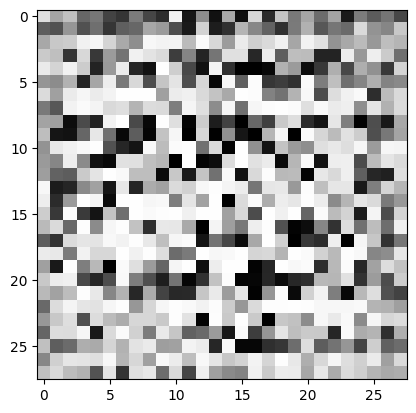

In [328]:
# noise=tf.random.normal(shape=[1,num_features])
# generated_image=generator(noise,training=False)
# plot_utils.show(generated_image,1)
gen = Generator()
test_gen_noise = get_noise(1,gen.z_dim)
test_uns_gen_noise = gen.unsqueeze_noise(test_gen_noise)
generated_image=gen(test_uns_gen_noise)
show_tensor_images(generated_image,1)


## Task 5: Build the Discriminator Network for DCGAN

In [329]:
#  discriminator=keras.models.Sequential([
#     keras.layers.Conv2D(64,(5,5),(2,2),padding="same",input_shape=[28,28,1]),
#     keras.layers.LeakyReLU(0.2),
#     keras.layers.Dropout(0.3),
#     keras.layers.Conv2D(128,(5,5),(2,2),padding="same"),
#     keras.layers.LeakyReLU(0.2),
#     keras.layers.Dropout(0.3),
#     keras.layers.Flatten(),
#     keras.layers.Dense(1,activation="sigmoid")    
# ])


In [330]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (Fashion_MNIST is black-and-white, so 1 channel is your default)
    hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1,final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2,final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of DCGAN, 
        corresponding to a convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        
        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(negative_slope=0.2, inplace=True)
            )
        else: # Final Layer
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

In [331]:
disc=Discriminator()
decision= disc(generated_image)
print(decision)

tensor([[0.0692]], grad_fn=<ViewBackward0>)


## Task 6: Compile the Deep Convolutional Generative Adversarial Network (DCGAN)

In [332]:
# discriminator.compile(loss="binary_crossentropy",optimizer="rmsprop")
# discriminator.trainable=False
# gan=keras.models.Sequential([generator,discriminator])
# gan.compile(loss="binary_crossentropy",optimizer="rmsprop")

In [346]:
criterion = nn.BCEWithLogitsLoss()
z_dim = 100
display_step = 500
device = 'cuda'
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), )
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters())
# You initialize the weights to the normal distribution
# with mean 0 and standard deviation 0.02
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

## Task 7: Define Training Procedure

In [335]:
# seed=tf.random.normal(shape=[batch_size,100])

In [336]:
# def train_dcgan(gan,dataset,batch_size,num_features,epochs=5):
#     generator,discriminator=gan.layers
#     for epoch in tqdm(range(epochs)):
#         print("Epoch {}/{}".format(epoch+1,epochs))
#         for X_batch in dataset:
#             noise=tf.random.normal(shape=[batch_size,num_features])
#             generated_images=generator(noise)
#             X_fake_and_real=tf.concat([generated_images,X_batch],axis=0)
#             y1=tf.constant([[0.]]*batch_size+[[1.]]*batch_size)
#             discriminator.trainable=True
#             discriminator.train_on_batch(X_fake_and_real,y1)
#             y2=tf.constant([[1.]]*batch_size)
#             discriminator.trainable=False
#             gan.train_on_batch(noise,y2)
#         display.clear_output(wait=True)
#         generate_and_save_images(generator,epoch+1,seed)
#     display.clear_output(wait=True)
#     generate_and_save_images(generator,epochs,seed)
        

In [360]:
def train_gan(n_epochs,cur_step,mean_generator_loss,mean_discriminator_loss,gen,gen_opt,disc,disc_opt,dataloader,criterion,z_dim,display_step,device):
    for epoch in range(n_epochs):
        # Dataloader returns the batches
        for real, _ in tqdm(dataloader):
            cur_batch_size = len(real)
            real = real.to(device)
    
            ## Update discriminator ##
            disc_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            disc_fake_pred = disc(fake.detach())
            disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
            disc_real_pred = disc(real)
            disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
            disc_loss = (disc_fake_loss + disc_real_loss) / 2
    
            # Keep track of the average discriminator loss
            mean_discriminator_loss += disc_loss.item() / display_step
            # Update gradients
            disc_loss.backward(retain_graph=True)
            # Update optimizer
            disc_opt.step()
    
            ## Update generator ##
            gen_opt.zero_grad()
            fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
            fake_2 = gen(fake_noise_2)
            disc_fake_pred = disc(fake_2)
            gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
            gen_loss.backward()
            gen_opt.step()
    
            # Keep track of the average generator loss
            mean_generator_loss += gen_loss.item() / display_step
    
            ## Visualization code ##
            if cur_step % display_step == 0 and cur_step > 0:
                print(f"Epoch {epoch}, step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
                save_tensor_images(fake,epoch)
                show_tensor_images(real)
                mean_generator_loss = 0
                mean_discriminator_loss = 0
            cur_step += 1

In [361]:
# ## Source https://www.tensorflow.org/tutorials/generative/dcgan#create_a_gif
# def generate_and_save_images(model, epoch, test_input):
#     predictions = model(test_input, training=False)
#     fig = plt.figure(figsize=(10,10))
    
#     for i in range(25):
#         plt.subplot(5, 5, i+1)
#         plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='binary')
#         plt.axis('off')
#     plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
#     plt.show()

In [362]:
def save_tensor_images(image_tensor, epoch,num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

## Task 8: Train DCGAN

In [363]:
# x_train_dcgan=x_train.reshape(-1,28,28,1)*2. -1.

In [364]:
# batch_size=32
# dataset=tf.data.Dataset.from_tensor_slices(x_train_dcgan).shuffle(1000)
# dataset=dataset.batch(batch_size,drop_remainder=True).prefetch(1)


In [365]:
# %%time
# train_dcgan(gan,dataset,batch_size,num_features,epochs=10)


In [366]:
dataloader=train_dataloader

 53%|██████████████████████████████████████████▋                                     | 500/938 [00:03<00:02, 170.83it/s]

Epoch 0, step 500: Generator loss: 1.8695509668588643, discriminator loss: 0.40715793931484245


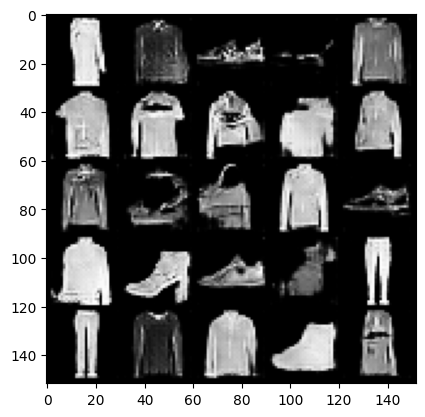

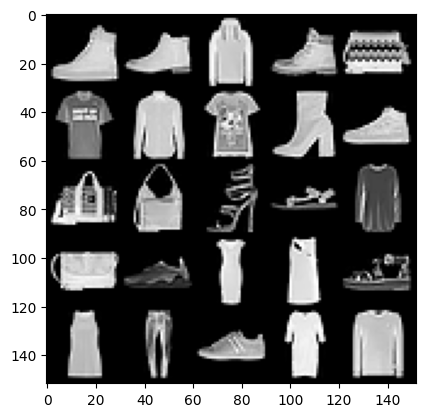

  5%|████▏                                                                            | 48/938 [00:00<00:05, 154.61it/s]

Epoch 1, step 1000: Generator loss: 1.8955585104227062, discriminator loss: 0.4246797074675561


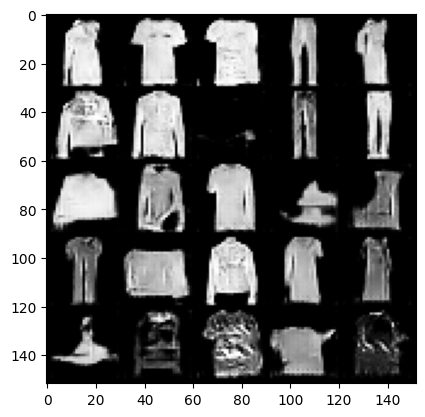

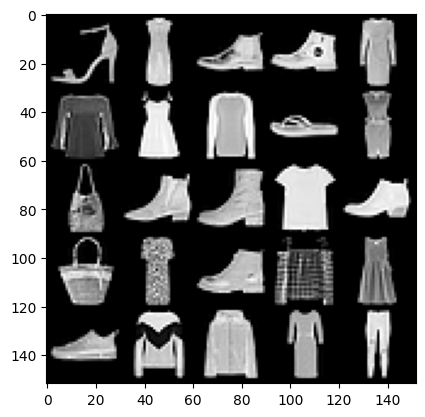

 59%|██████████████████████████████████████████████▉                                 | 550/938 [00:03<00:02, 155.85it/s]

Epoch 1, step 1500: Generator loss: 1.8975539653301234, discriminator loss: 0.4132720279097553


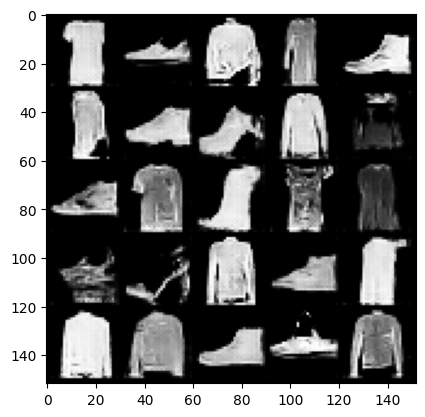

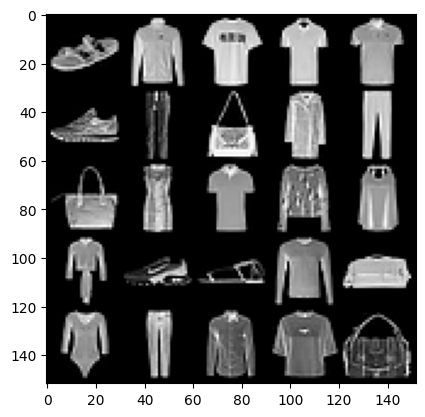

 12%|█████████▍                                                                      | 111/938 [00:00<00:05, 154.30it/s]

Epoch 2, step 2000: Generator loss: 1.8544696381092052, discriminator loss: 0.40803540617227524


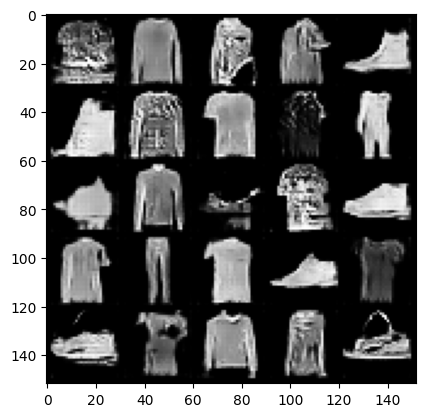

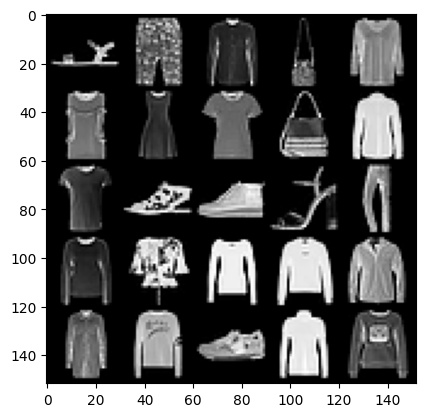

 66%|████████████████████████████████████████████████████▌                           | 617/938 [00:04<00:01, 168.06it/s]

Epoch 2, step 2500: Generator loss: 1.8983793517351153, discriminator loss: 0.4094827797412871


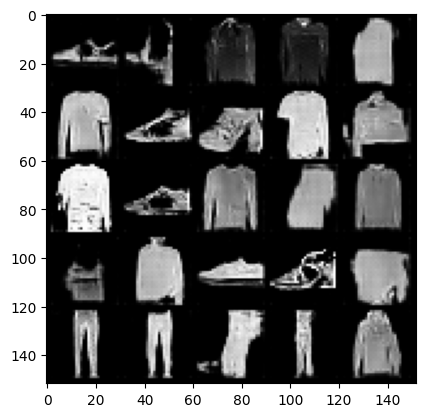

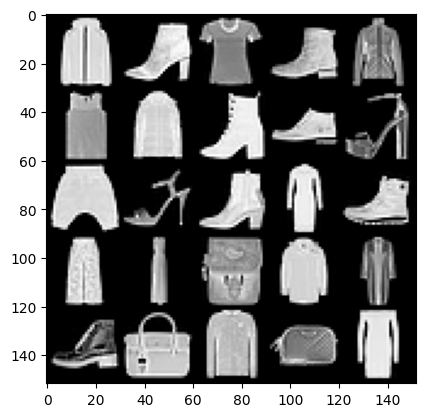

 18%|██████████████▌                                                                 | 171/938 [00:01<00:04, 162.72it/s]

Epoch 3, step 3000: Generator loss: 1.8772864825725544, discriminator loss: 0.4145008847117422


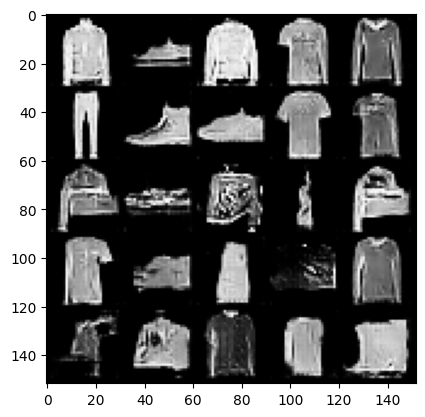

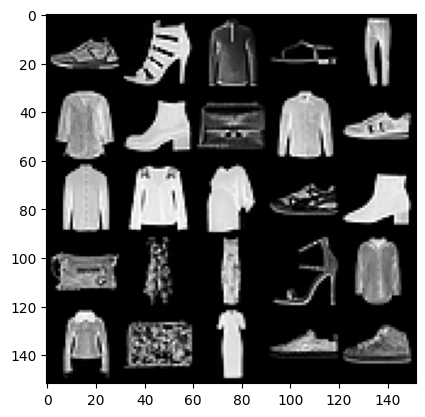

 73%|██████████████████████████████████████████████████████████                      | 681/938 [00:04<00:01, 158.58it/s]

Epoch 3, step 3500: Generator loss: 1.9082238454818723, discriminator loss: 0.40830066806077886


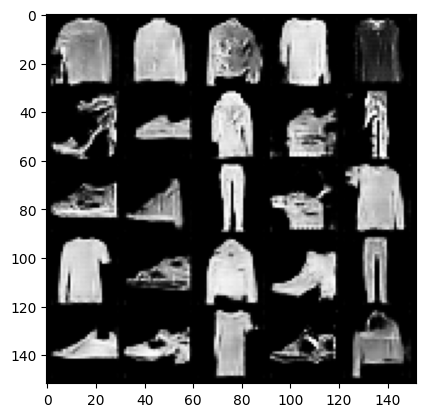

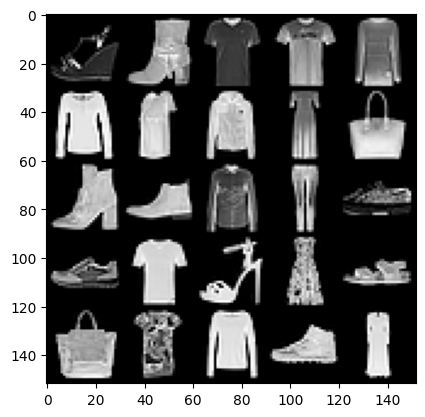

 26%|████████████████████▋                                                           | 242/938 [00:01<00:04, 151.45it/s]

Epoch 4, step 4000: Generator loss: 1.8293910927772532, discriminator loss: 0.41782340657711026


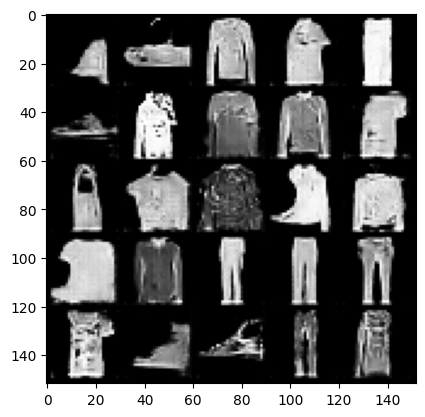

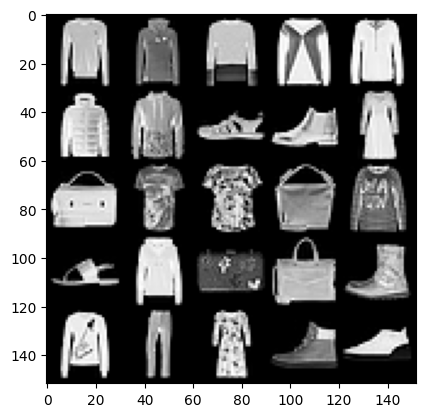

 79%|███████████████████████████████████████████████████████████████▎                | 742/938 [00:04<00:01, 157.23it/s]

Epoch 4, step 4500: Generator loss: 1.9020740741491307, discriminator loss: 0.41417126211523975


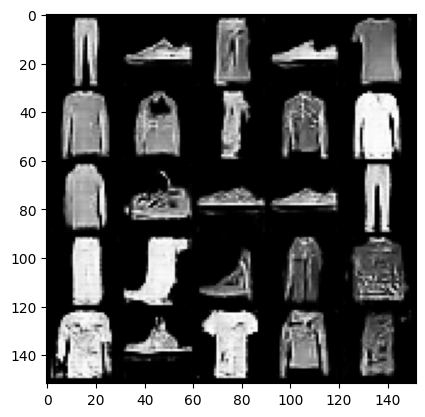

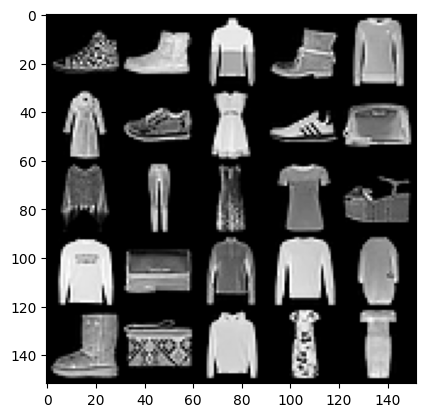

 33%|██████████████████████████▍                                                     | 310/938 [00:01<00:04, 150.42it/s]

Epoch 5, step 5000: Generator loss: 1.9104283529520028, discriminator loss: 0.41726174664497434


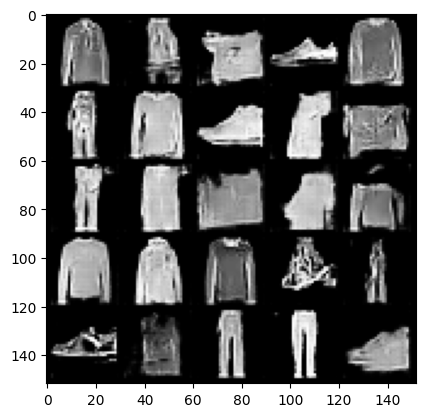

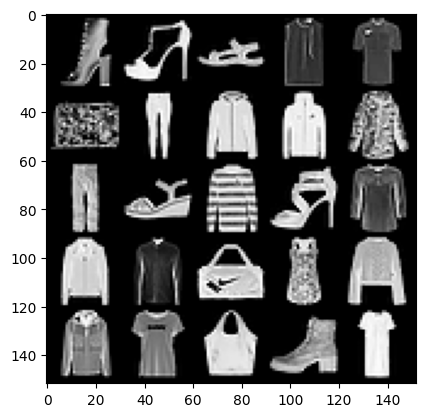

 85%|███████████████████████████████████████████████████████████████████▊            | 795/938 [00:05<00:00, 153.57it/s]

Epoch 5, step 5500: Generator loss: 1.8990432040691378, discriminator loss: 0.4188040134310725


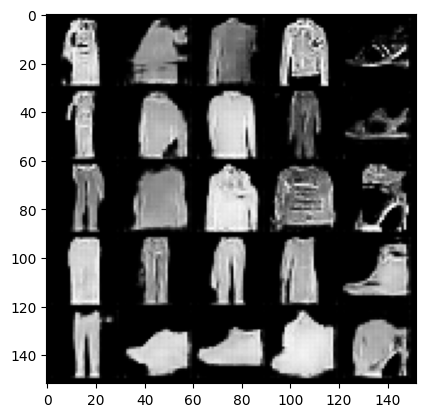

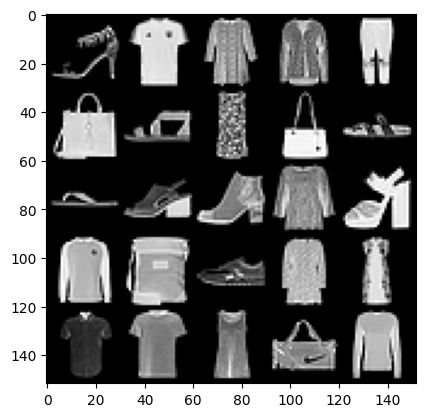

 39%|███████████████████████████████▏                                                | 366/938 [00:02<00:03, 160.83it/s]

Epoch 6, step 6000: Generator loss: 1.9056495393514616, discriminator loss: 0.40278738811612175


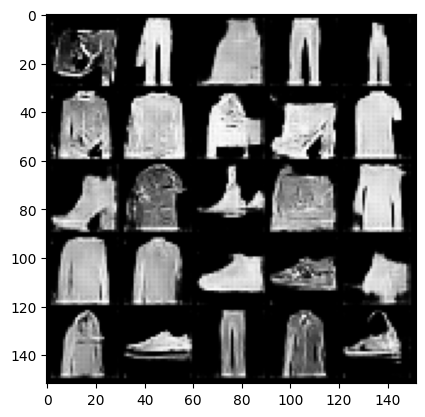

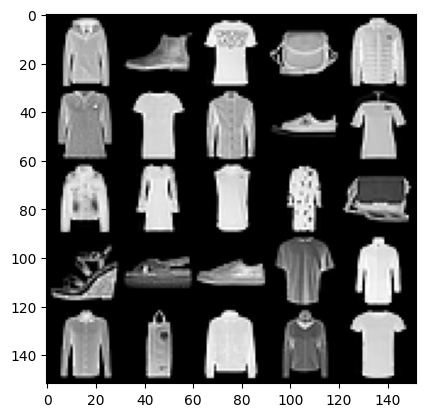

 93%|██████████████████████████████████████████████████████████████████████████▎     | 871/938 [00:05<00:00, 156.45it/s]

Epoch 6, step 6500: Generator loss: 1.9015373579263692, discriminator loss: 0.4085417995452879


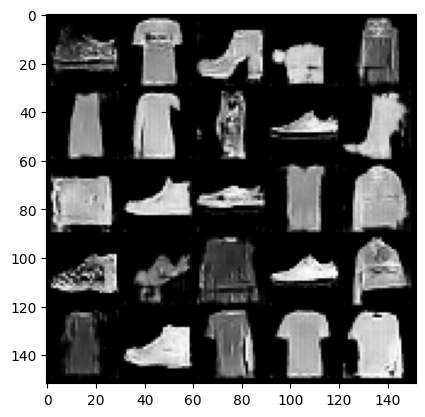

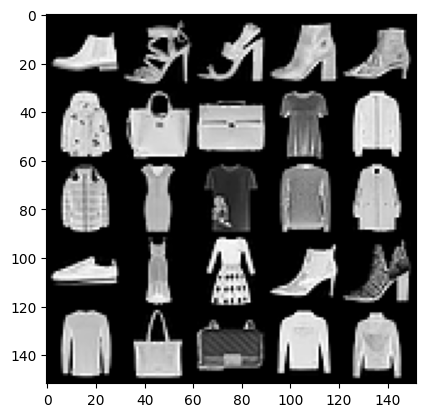

 46%|████████████████████████████████████▉                                           | 433/938 [00:02<00:03, 153.90it/s]

Epoch 7, step 7000: Generator loss: 1.9932190146446223, discriminator loss: 0.41060219994187336


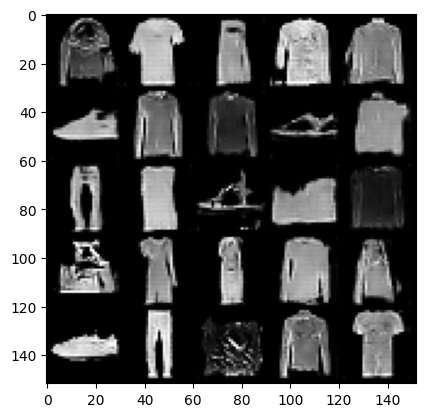

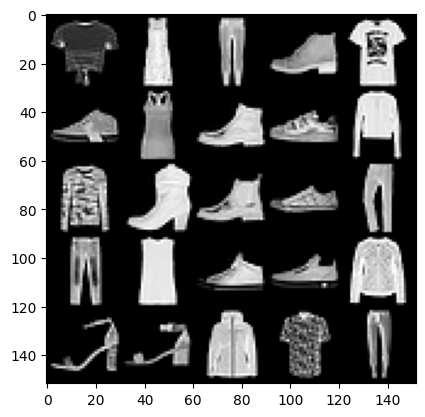

 99%|██████████████████████████████████████████████████████████████████████████████▊ | 924/938 [00:06<00:00, 139.18it/s]

Epoch 7, step 7500: Generator loss: 1.9205525225400941, discriminator loss: 0.4066743853688243


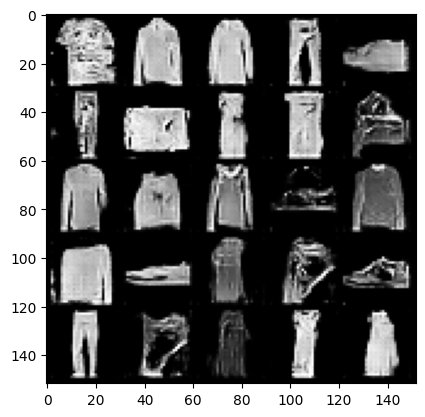

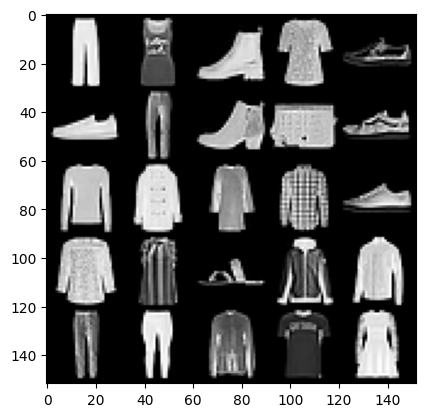

 52%|█████████████████████████████████████████▎                                      | 485/938 [00:03<00:03, 150.10it/s]

Epoch 8, step 8000: Generator loss: 1.915950622797014, discriminator loss: 0.41541973036527635


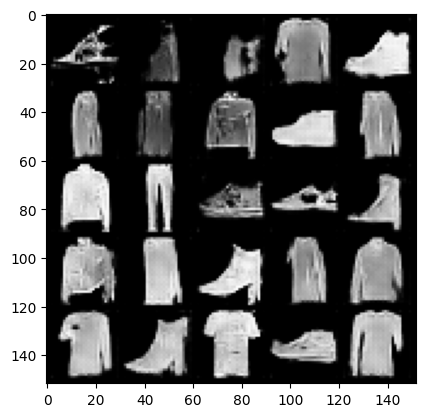

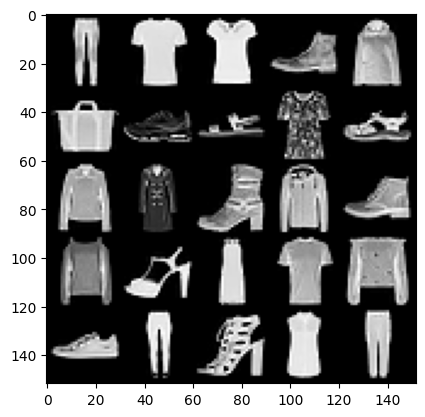

  5%|████▏                                                                            | 48/938 [00:00<00:05, 152.57it/s]

Epoch 9, step 8500: Generator loss: 1.8810390478372565, discriminator loss: 0.409059126764536


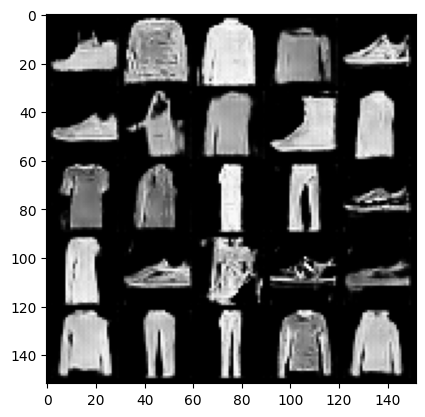

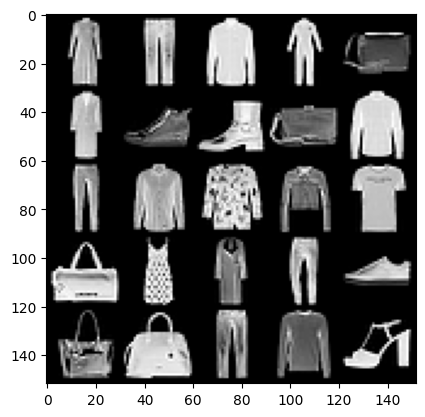

 58%|██████████████████████████████████████████████▏                                 | 542/938 [00:03<00:02, 159.83it/s]

Epoch 9, step 9000: Generator loss: 1.9091651686429962, discriminator loss: 0.41251122316718086


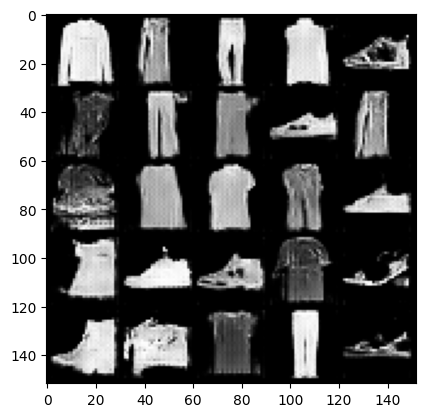

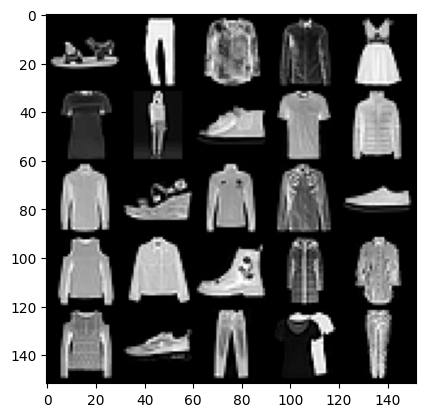

 12%|█████████▉                                                                      | 116/938 [00:00<00:05, 151.86it/s]

Epoch 10, step 9500: Generator loss: 1.9652858453989017, discriminator loss: 0.4068319681882859


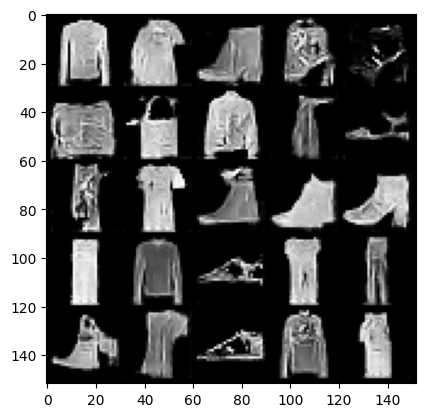

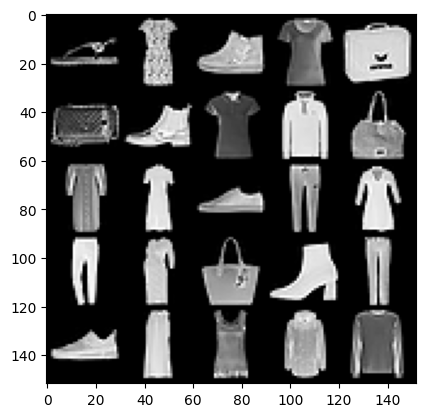

 65%|███████████████████████████████████████████████████▉                            | 609/938 [00:04<00:02, 151.98it/s]

Epoch 10, step 10000: Generator loss: 1.8749050457477567, discriminator loss: 0.4095648720562453


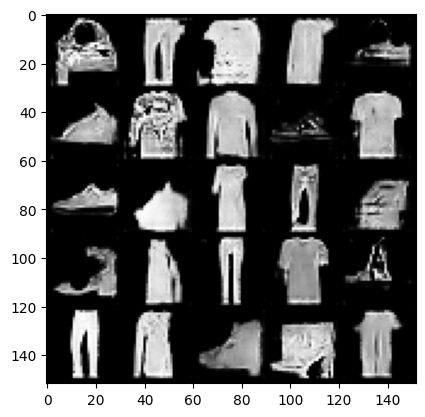

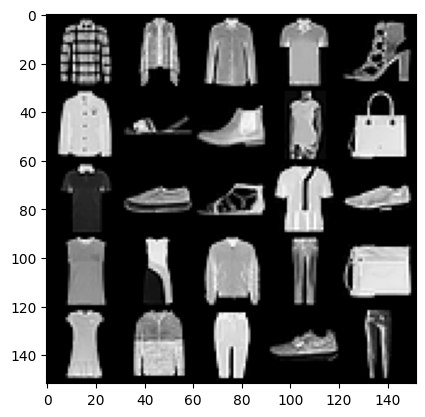

 18%|██████████████▎                                                                 | 168/938 [00:01<00:05, 147.57it/s]

Epoch 11, step 10500: Generator loss: 1.92241812634468, discriminator loss: 0.40513721948862075


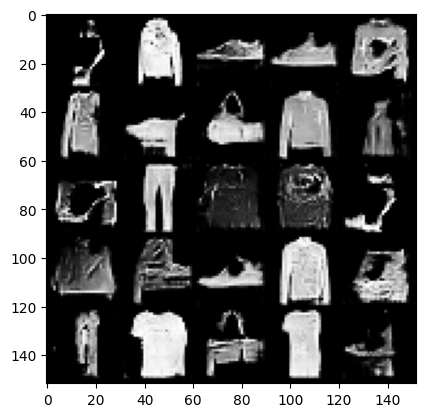

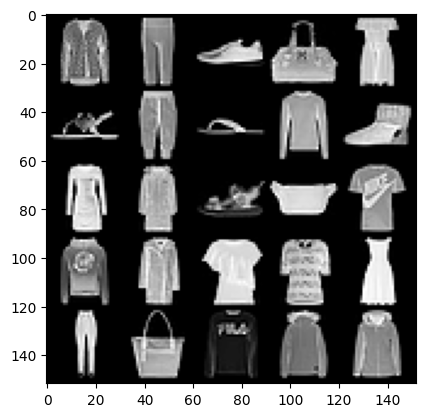

 72%|█████████████████████████████████████████████████████████▍                      | 673/938 [00:04<00:01, 152.63it/s]

Epoch 11, step 11000: Generator loss: 1.8526873307228078, discriminator loss: 0.41155125388503055


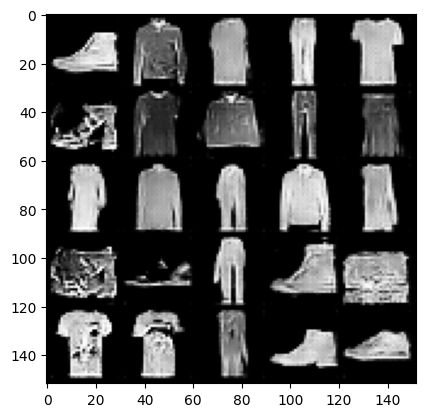

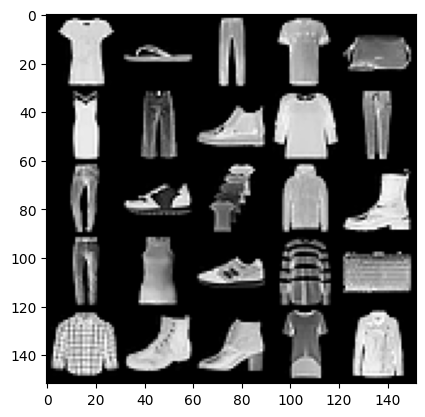

 26%|████████████████████▋                                                           | 243/938 [00:01<00:04, 145.20it/s]

Epoch 12, step 11500: Generator loss: 2.0389834171533603, discriminator loss: 0.4064943658113478


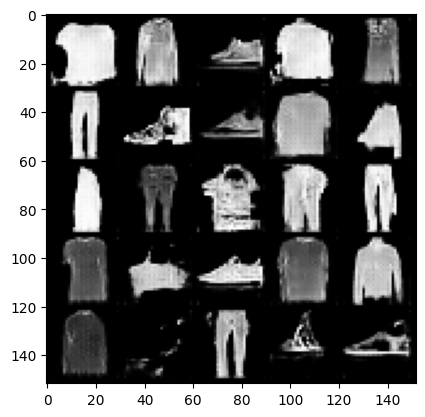

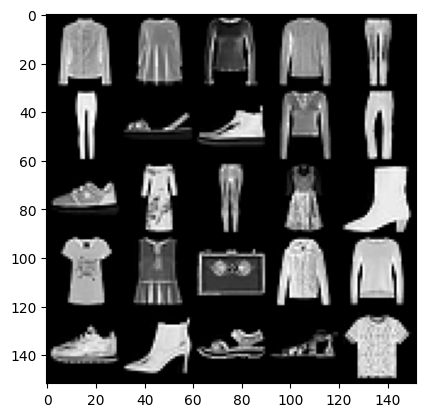

 79%|███████████████████████████████████████████████████████████████▎                | 742/938 [00:05<00:01, 146.59it/s]

Epoch 12, step 12000: Generator loss: 1.9352960586547845, discriminator loss: 0.4039350063800811


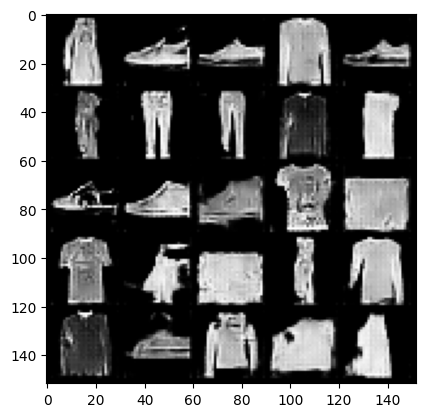

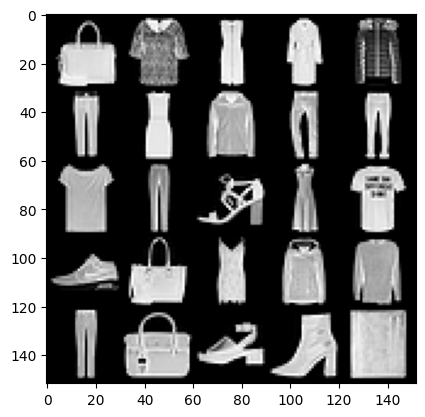

 32%|█████████████████████████▊                                                      | 303/938 [00:01<00:04, 152.04it/s]

Epoch 13, step 12500: Generator loss: 1.9235360608100882, discriminator loss: 0.40605628466606136


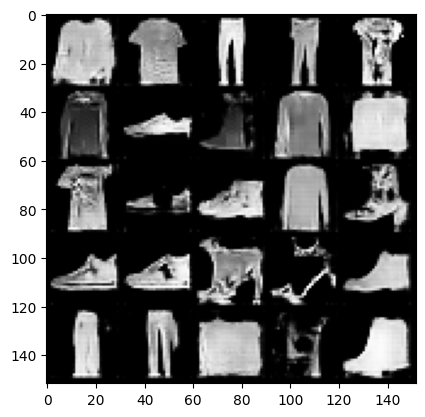

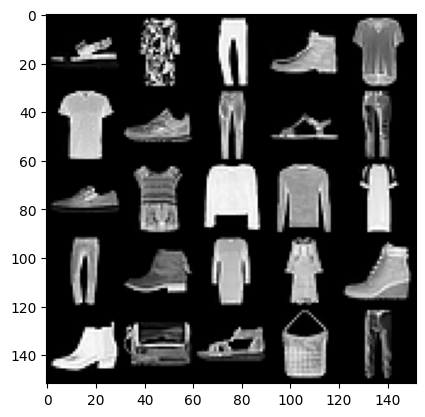

 85%|███████████████████████████████████████████████████████████████████▊            | 795/938 [00:05<00:00, 149.01it/s]

Epoch 13, step 13000: Generator loss: 1.957190253973007, discriminator loss: 0.4065868773460386


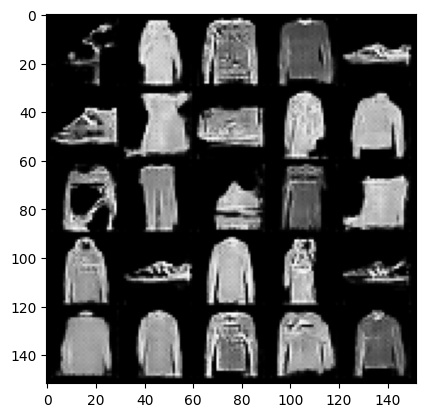

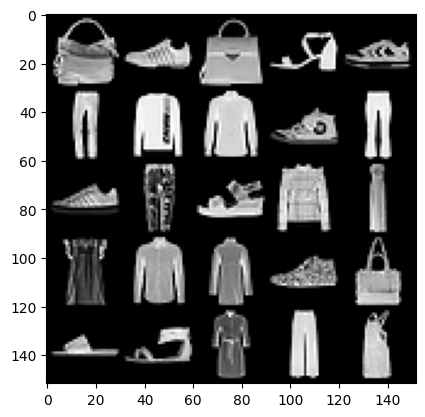

 39%|███████████████████████████████                                                 | 364/938 [00:02<00:03, 152.26it/s]

Epoch 14, step 13500: Generator loss: 1.9648840082883843, discriminator loss: 0.41469135311245886


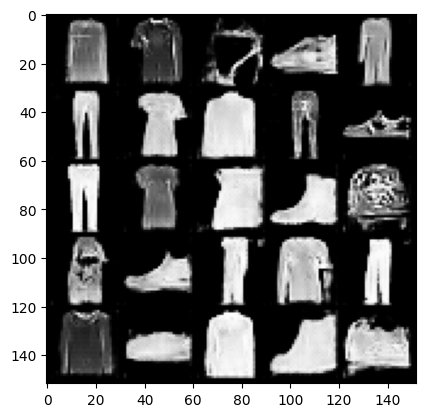

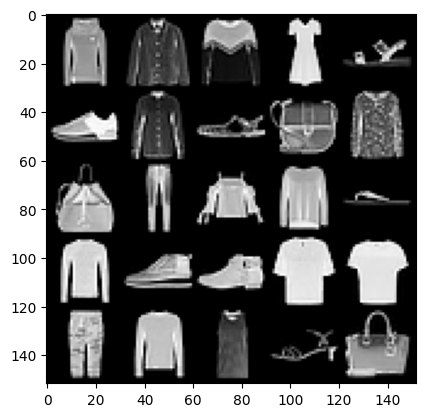

 91%|████████████████████████████████████████████████████████████████████████▊       | 853/938 [00:05<00:00, 152.49it/s]

Epoch 14, step 14000: Generator loss: 1.9512667167186741, discriminator loss: 0.4114843170046808


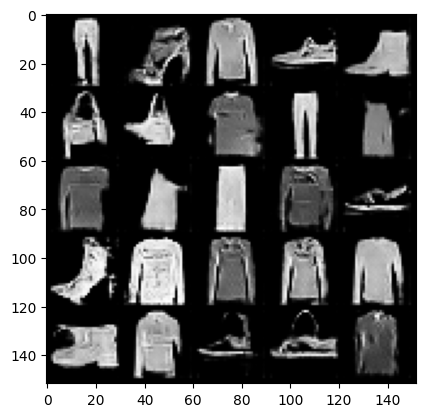

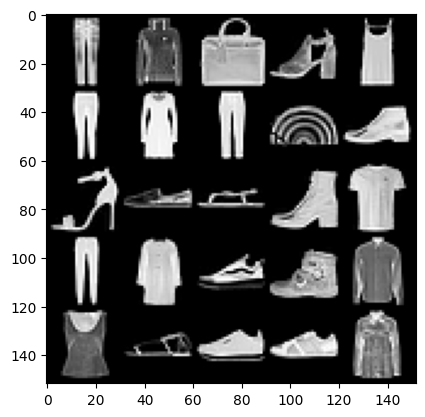

 45%|████████████████████████████████████▎                                           | 426/938 [00:02<00:03, 153.56it/s]

Epoch 15, step 14500: Generator loss: 1.9267858703136456, discriminator loss: 0.4097837727367877


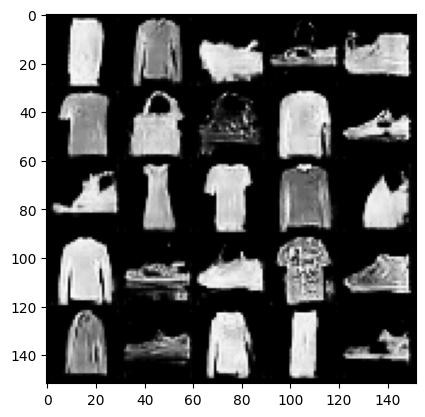

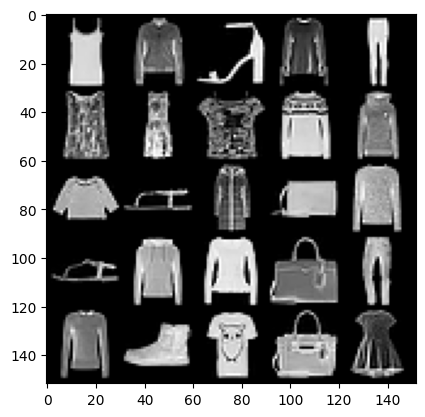

 99%|██████████████████████████████████████████████████████████████████████████████▉ | 926/938 [00:06<00:00, 156.91it/s]

Epoch 15, step 15000: Generator loss: 1.9709716739654557, discriminator loss: 0.4121328792572017


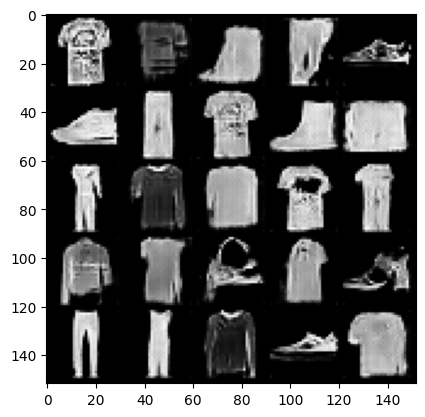

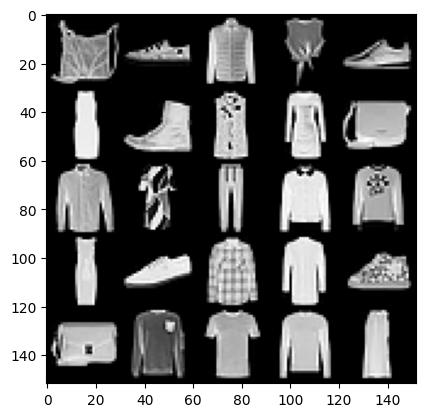

 52%|█████████████████████████████████████████▋                                      | 489/938 [00:02<00:02, 163.80it/s]

Epoch 16, step 15500: Generator loss: 1.9393241121768947, discriminator loss: 0.41635605463385605


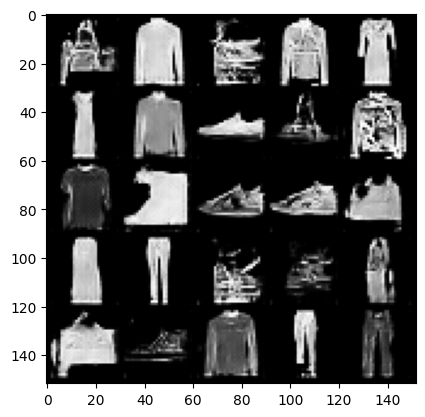

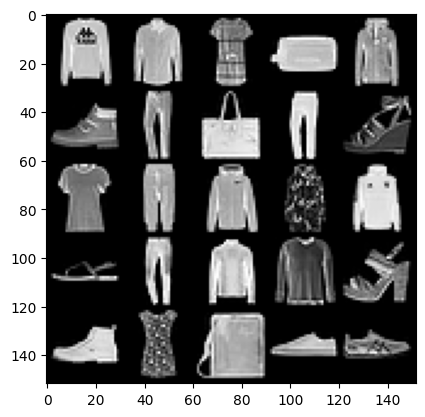

  5%|████▍                                                                            | 51/938 [00:00<00:05, 159.10it/s]

Epoch 17, step 16000: Generator loss: 1.9363235496282571, discriminator loss: 0.4082598427832125


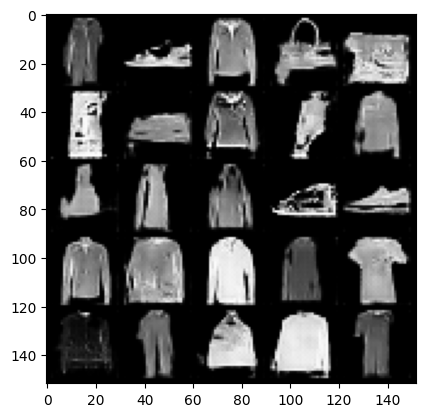

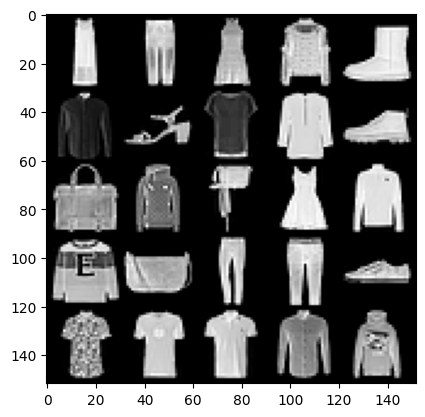

 59%|██████████████████████████████████████████████▉                                 | 550/938 [00:03<00:02, 157.50it/s]

Epoch 17, step 16500: Generator loss: 2.0191769312620167, discriminator loss: 0.4007386593520642


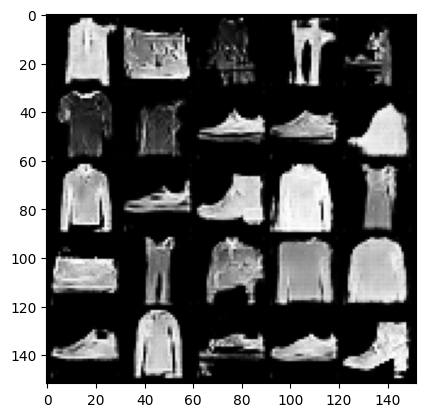

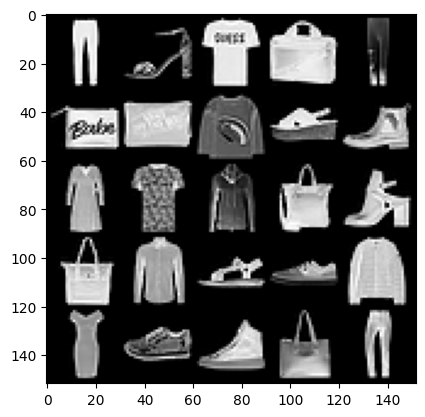

 12%|█████████▋                                                                      | 113/938 [00:00<00:05, 155.57it/s]

Epoch 18, step 17000: Generator loss: 1.948524983763693, discriminator loss: 0.3958485344052316


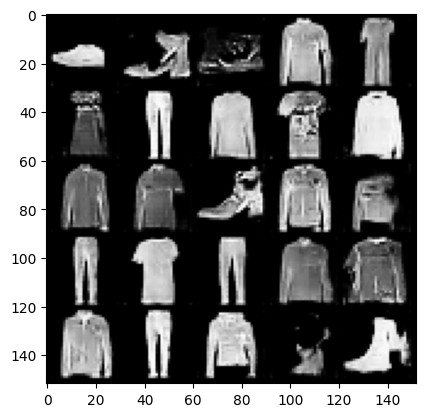

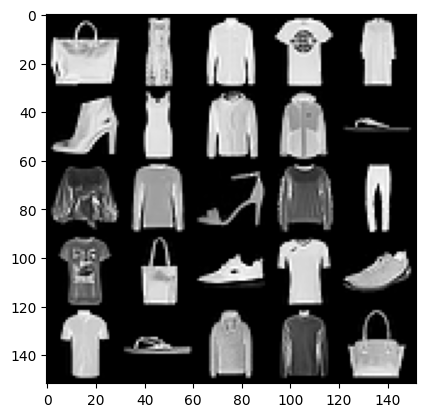

 64%|███████████████████████████████████████████████████▎                            | 602/938 [00:04<00:02, 148.15it/s]

Epoch 18, step 17500: Generator loss: 1.9368238544464105, discriminator loss: 0.40384127166867273


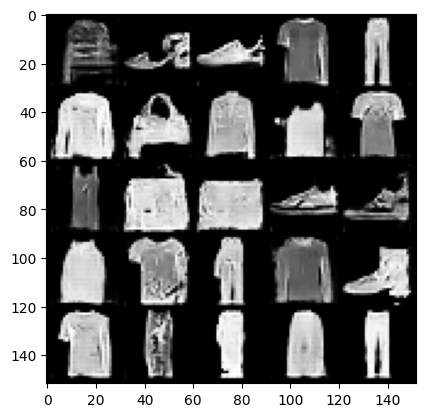

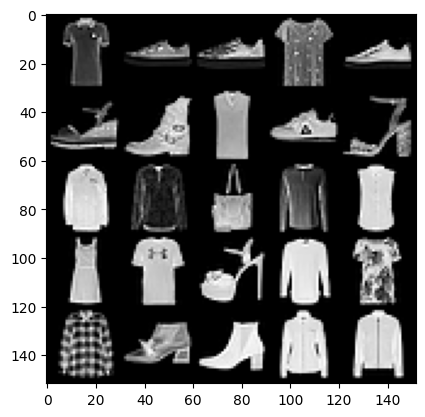

 19%|███████████████▏                                                                | 178/938 [00:01<00:04, 154.83it/s]

Epoch 19, step 18000: Generator loss: 1.9493781352043151, discriminator loss: 0.3950451805293559


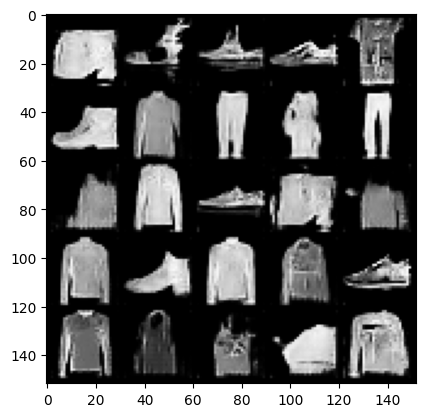

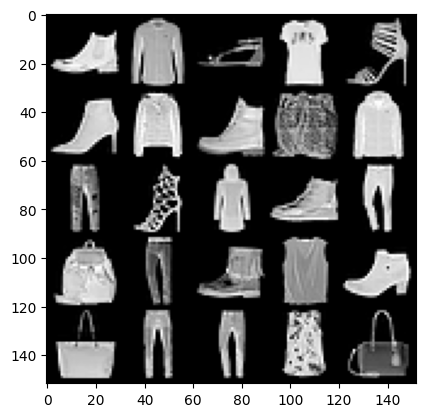

 71%|████████████████████████████████████████████████████████▌                       | 663/938 [00:04<00:01, 163.18it/s]

Epoch 19, step 18500: Generator loss: 2.0141957958936683, discriminator loss: 0.39399880394339565


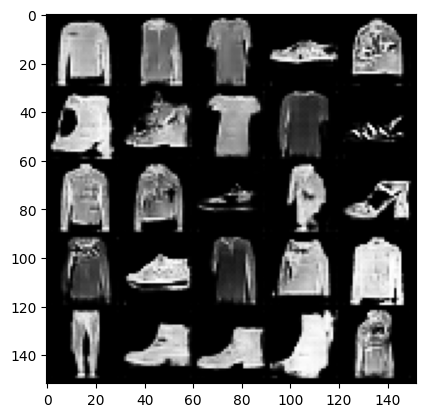

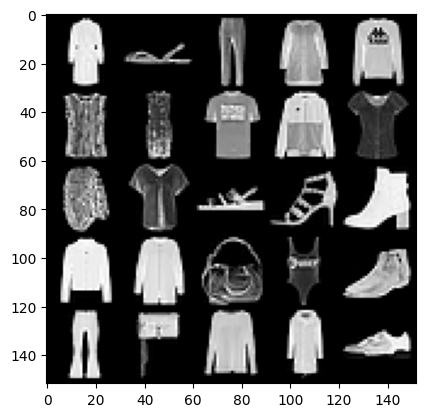

 25%|████████████████████                                                            | 235/938 [00:01<00:04, 160.17it/s]

Epoch 20, step 19000: Generator loss: 2.0296398718357094, discriminator loss: 0.387926490664482


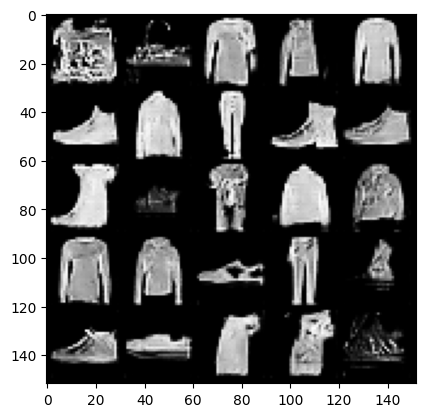

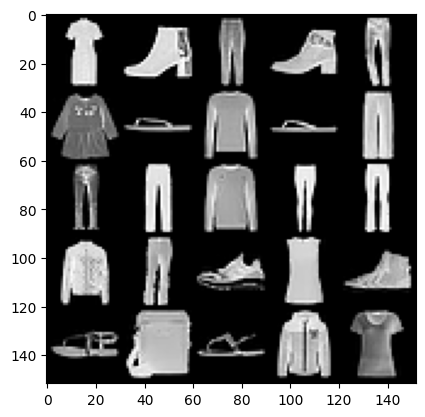

 78%|██████████████████████████████████████████████████████████████▍                 | 732/938 [00:04<00:01, 157.51it/s]

Epoch 20, step 19500: Generator loss: 2.0281416686773284, discriminator loss: 0.39634424337744745


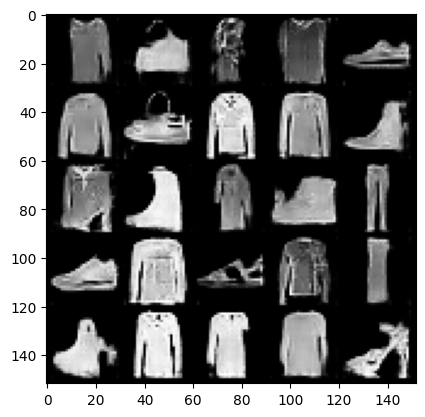

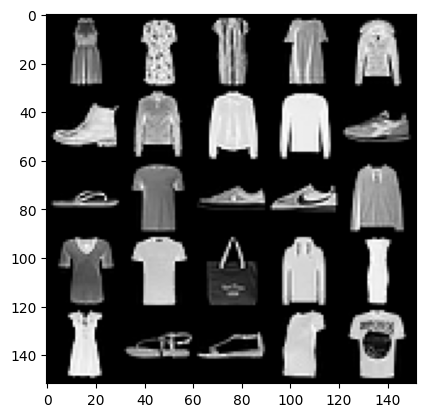

 31%|████████████████████████▋                                                       | 289/938 [00:01<00:04, 154.12it/s]

Epoch 21, step 20000: Generator loss: 2.047426721930505, discriminator loss: 0.39091503217816365


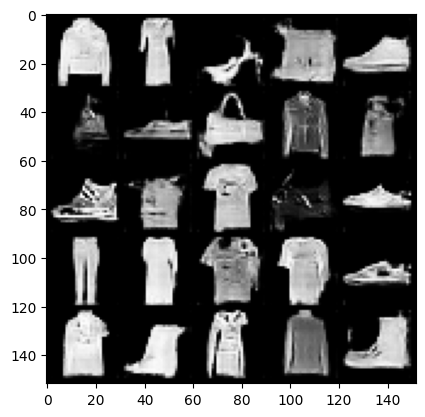

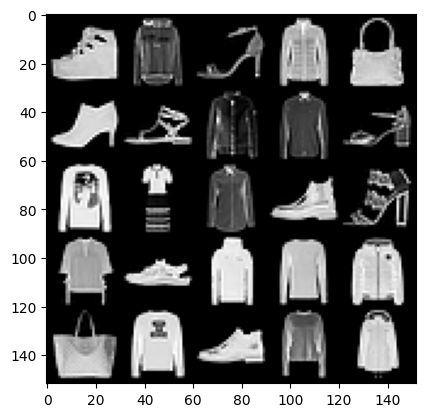

 85%|███████████████████████████████████████████████████████████████████▊            | 795/938 [00:05<00:00, 158.33it/s]

Epoch 21, step 20500: Generator loss: 1.9932734619379022, discriminator loss: 0.4070626080930233


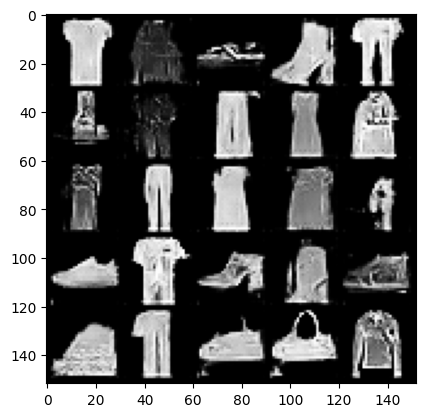

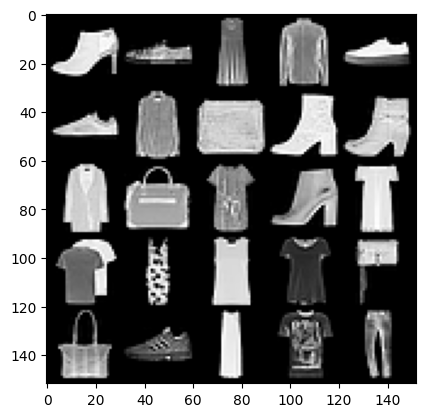

 38%|██████████████████████████████                                                  | 352/938 [00:02<00:03, 151.26it/s]

Epoch 22, step 21000: Generator loss: 1.969890802383426, discriminator loss: 0.40460027942061433


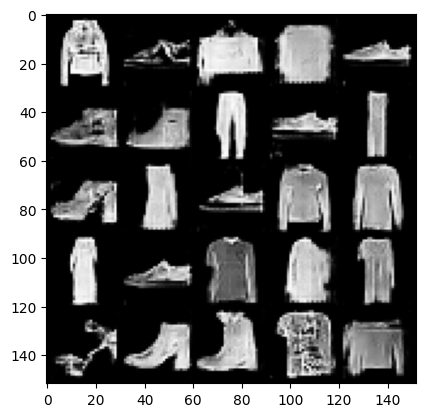

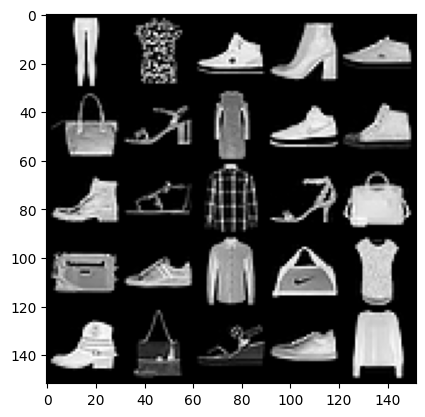

 92%|█████████████████████████████████████████████████████████████████████████▌      | 862/938 [00:05<00:00, 162.01it/s]

Epoch 22, step 21500: Generator loss: 2.012439593911171, discriminator loss: 0.3830096245110031


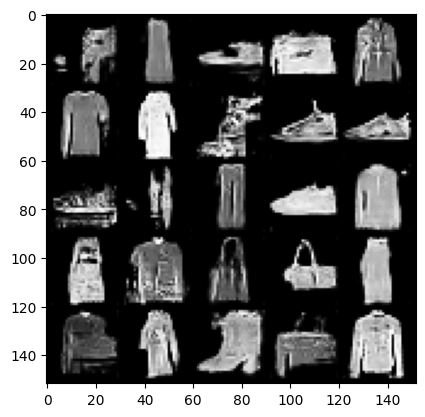

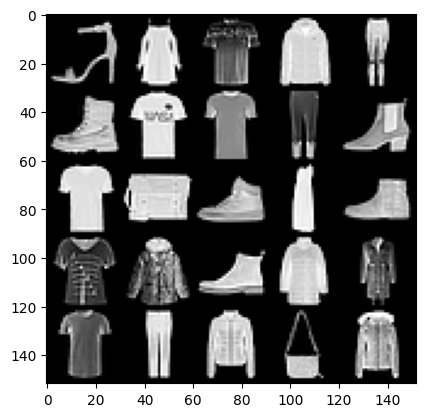

 45%|████████████████████████████████████                                            | 423/938 [00:02<00:03, 166.25it/s]

Epoch 23, step 22000: Generator loss: 2.011083194971087, discriminator loss: 0.39587002405524224


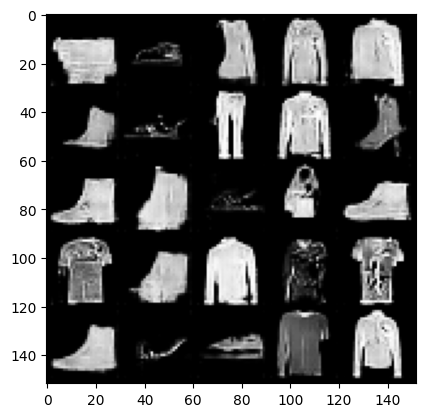

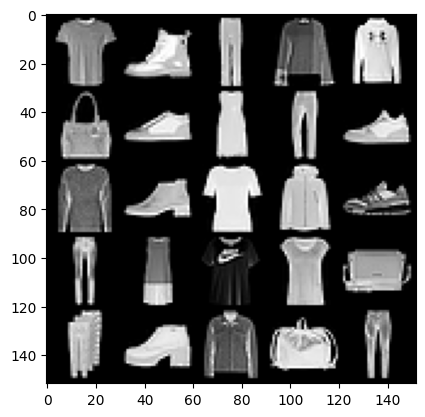

 98%|██████████████████████████████████████████████████████████████████████████████▋ | 923/938 [00:05<00:00, 157.40it/s]

Epoch 23, step 22500: Generator loss: 2.0012053295373926, discriminator loss: 0.3925705595910546


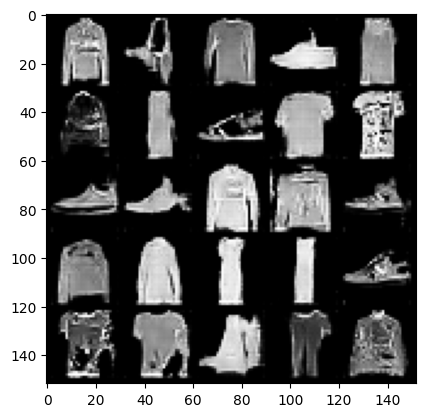

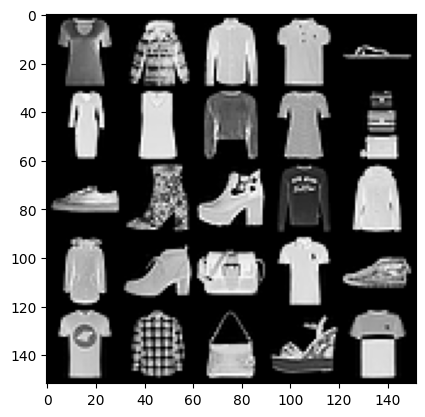

 52%|█████████████████████████████████████████▎                                      | 485/938 [00:03<00:02, 153.50it/s]

Epoch 24, step 23000: Generator loss: 2.033835355401037, discriminator loss: 0.3963706681132313


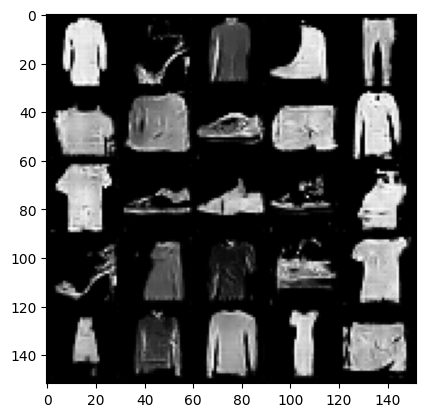

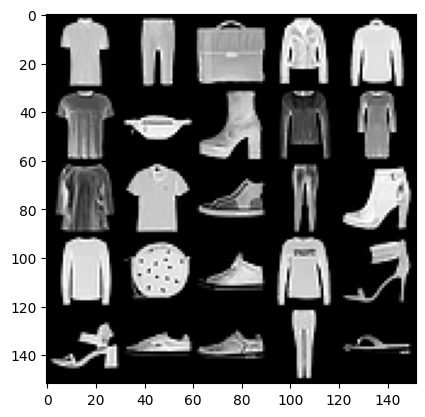

  5%|████▏                                                                            | 48/938 [00:00<00:05, 153.99it/s]

Epoch 25, step 23500: Generator loss: 2.0459042648077017, discriminator loss: 0.3887618129253389


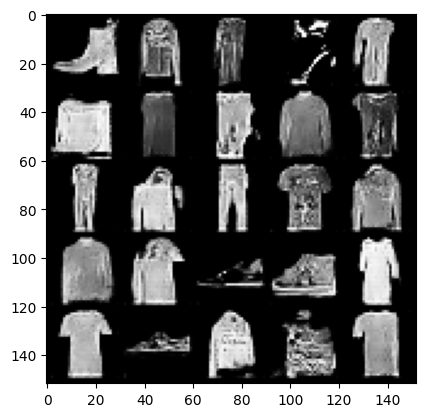

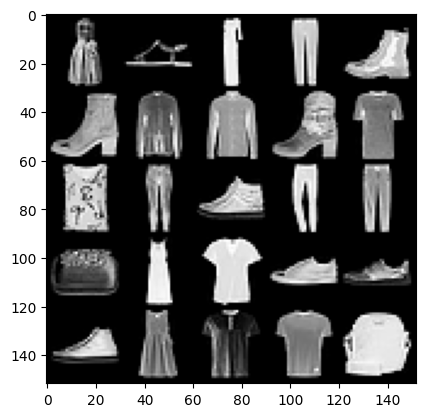

 58%|██████████████████████████████████████████████▏                                 | 541/938 [00:03<00:02, 150.67it/s]

Epoch 25, step 24000: Generator loss: 2.004162333011627, discriminator loss: 0.3878599607944491


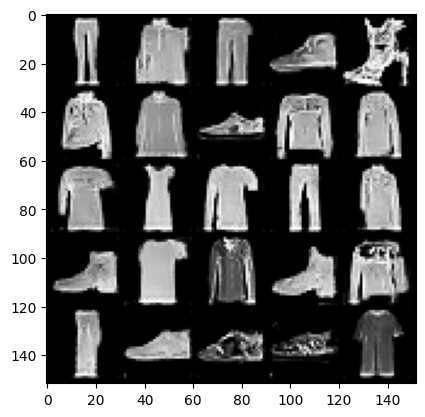

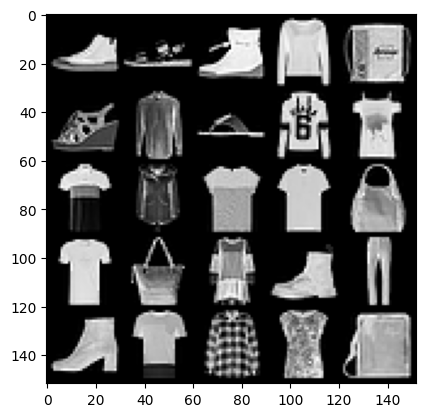

 12%|█████████▌                                                                      | 112/938 [00:00<00:05, 150.02it/s]

Epoch 26, step 24500: Generator loss: 2.0449991931915257, discriminator loss: 0.400938382089138


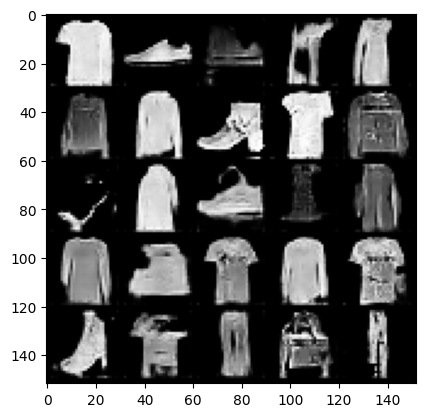

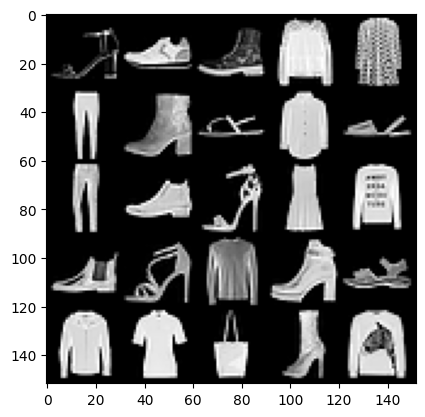

 64%|██████████████████████████████████████████████████▉                             | 597/938 [00:04<00:02, 161.80it/s]

Epoch 26, step 25000: Generator loss: 2.0131593428850185, discriminator loss: 0.39355682891607285


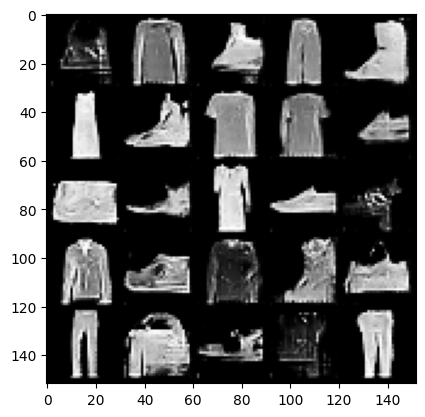

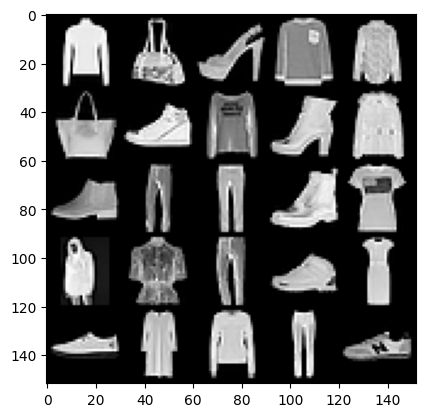

 18%|██████████████▌                                                                 | 171/938 [00:01<00:04, 166.03it/s]

Epoch 27, step 25500: Generator loss: 1.9960528132915496, discriminator loss: 0.39532421696186054


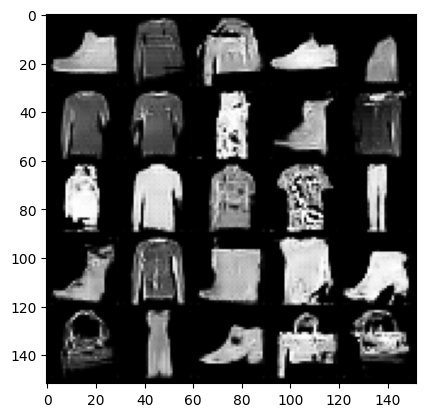

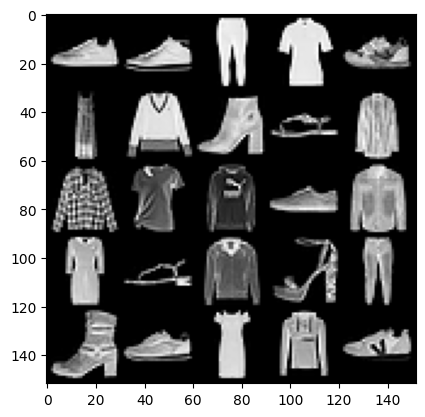

 70%|████████████████████████████████████████████████████████▍                       | 661/938 [00:04<00:01, 168.85it/s]

Epoch 27, step 26000: Generator loss: 2.09482343184948, discriminator loss: 0.39196977797150623


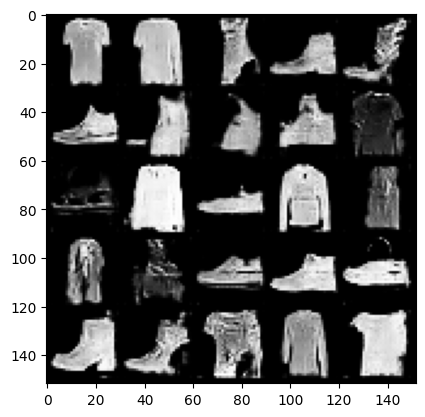

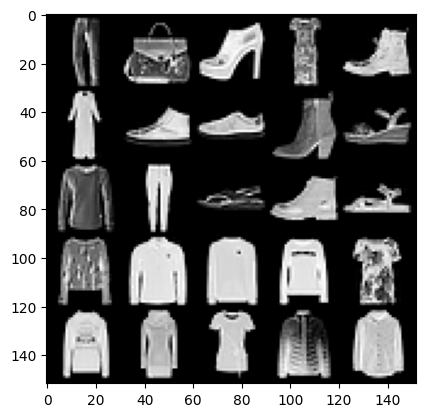

 25%|████████████████████▏                                                           | 236/938 [00:01<00:04, 151.11it/s]

Epoch 28, step 26500: Generator loss: 2.005089240074158, discriminator loss: 0.38657708221673953


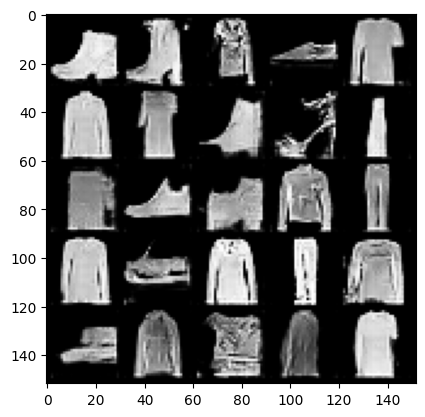

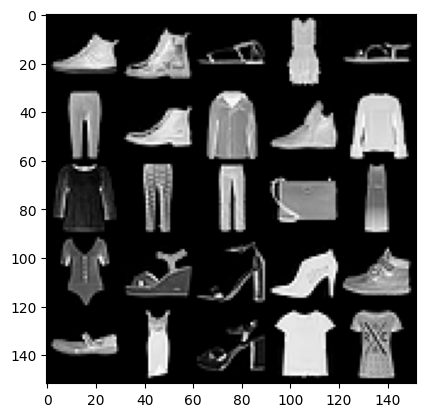

 77%|█████████████████████████████████████████████████████████████▉                  | 726/938 [00:04<00:01, 160.25it/s]

Epoch 28, step 27000: Generator loss: 1.999711752772332, discriminator loss: 0.39305819866061253


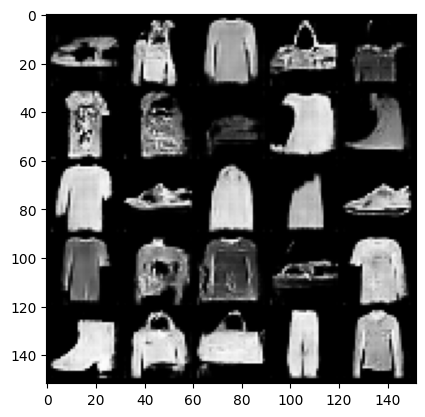

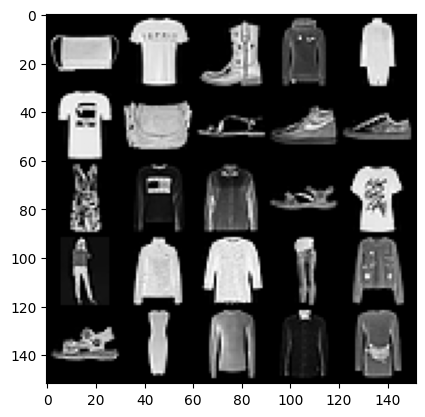

 31%|████████████████████████▍                                                       | 287/938 [00:01<00:04, 145.63it/s]

Epoch 29, step 27500: Generator loss: 2.1003436298370377, discriminator loss: 0.3897304645180703


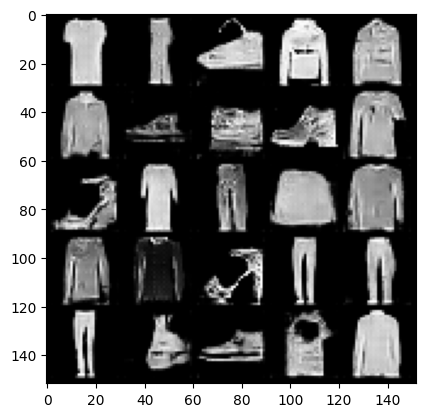

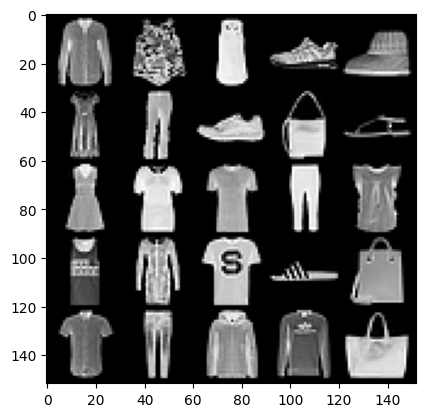

 85%|███████████████████████████████████████████████████████████████████▉            | 796/938 [00:05<00:00, 158.90it/s]

Epoch 29, step 28000: Generator loss: 2.0557321710586556, discriminator loss: 0.3929827413260938


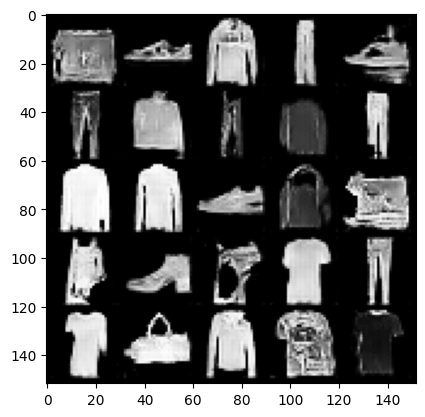

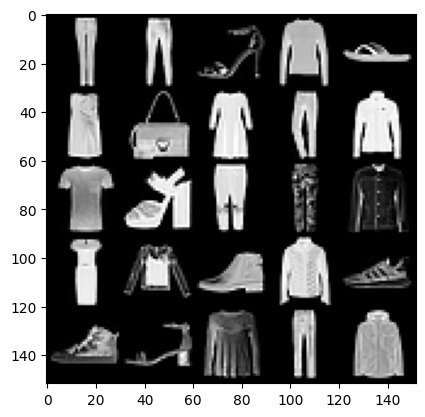

 38%|██████████████████████████████▎                                                 | 355/938 [00:02<00:03, 167.91it/s]

Epoch 30, step 28500: Generator loss: 2.0499346085786816, discriminator loss: 0.38881430730223643


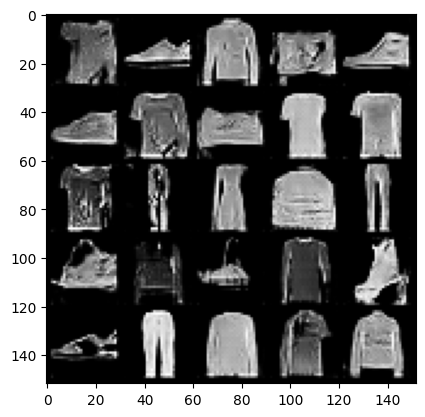

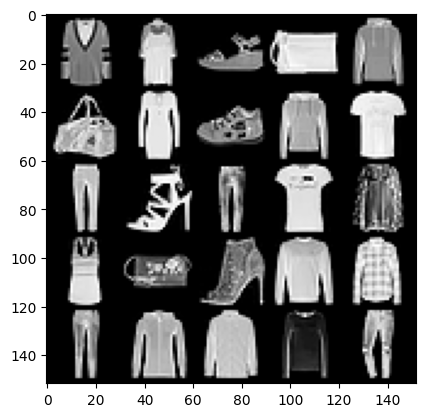

 91%|█████████████████████████████████████████████████████████████████████████       | 856/938 [00:05<00:00, 171.71it/s]

Epoch 30, step 29000: Generator loss: 2.0208769046068196, discriminator loss: 0.39208395376801464


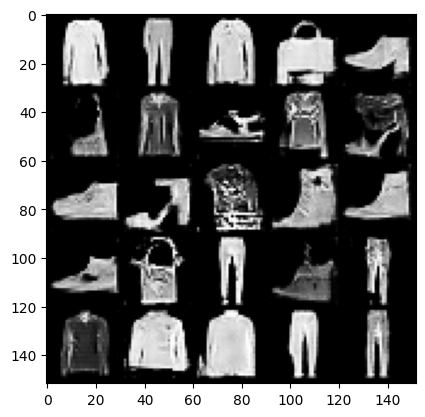

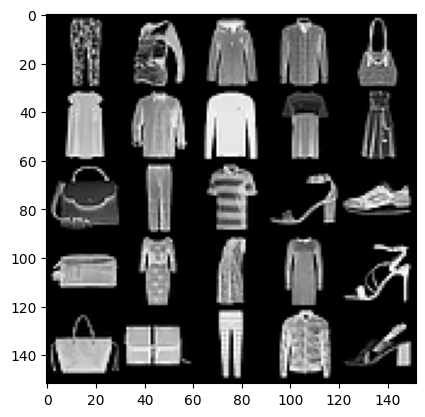

 44%|███████████████████████████████████▏                                            | 412/938 [00:02<00:03, 158.33it/s]

Epoch 31, step 29500: Generator loss: 2.020183254122736, discriminator loss: 0.3912854815423491


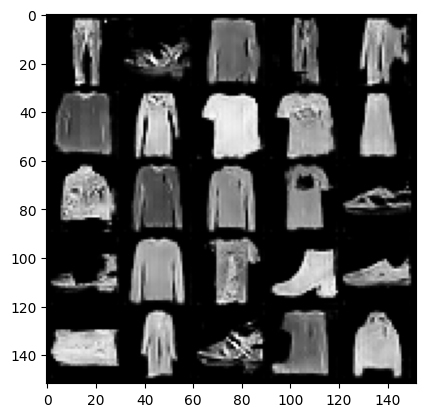

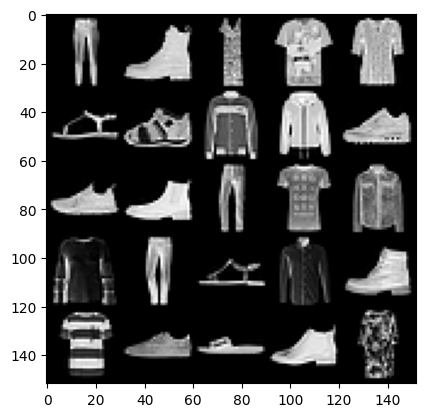

 98%|██████████████████████████████████████████████████████████████████████████████▌ | 921/938 [00:05<00:00, 155.69it/s]

Epoch 31, step 30000: Generator loss: 1.9771930662393582, discriminator loss: 0.38077067846059814


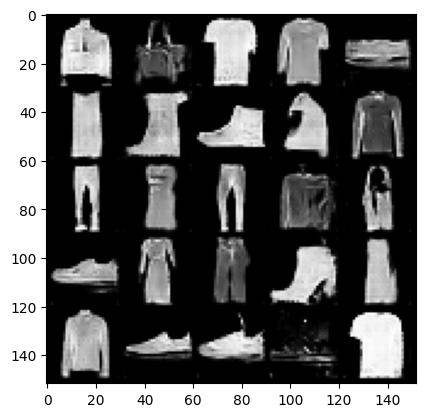

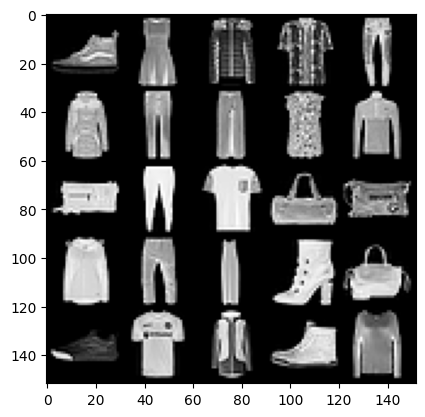

 50%|████████████████████████████████████████▏                                       | 471/938 [00:03<00:03, 152.18it/s]

Epoch 32, step 30500: Generator loss: 2.056537759900093, discriminator loss: 0.39349599944055014


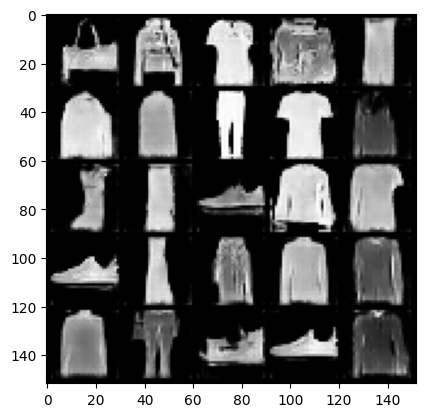

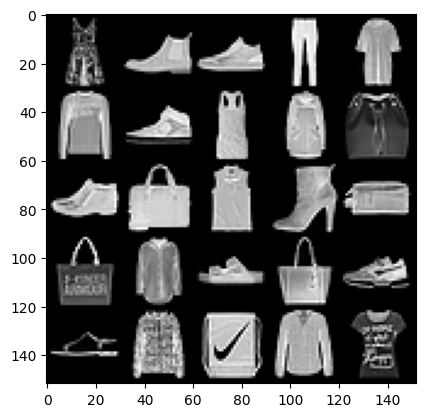

  3%|██▊                                                                              | 32/938 [00:00<00:05, 153.89it/s]

Epoch 33, step 31000: Generator loss: 2.1192258393764494, discriminator loss: 0.3982255843281746


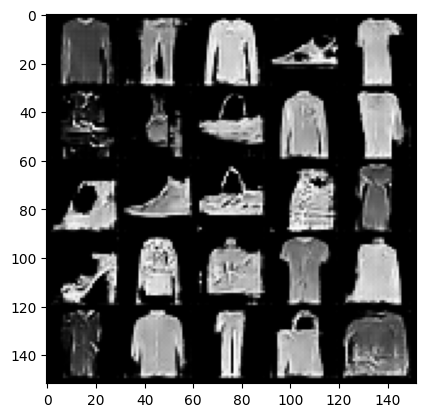

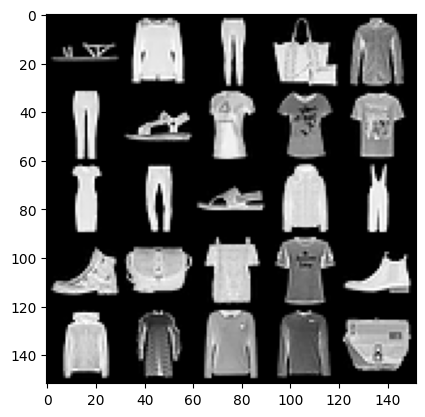

 57%|█████████████████████████████████████████████▊                                  | 537/938 [00:03<00:02, 153.38it/s]

Epoch 33, step 31500: Generator loss: 2.0554186820983893, discriminator loss: 0.3805329290926459


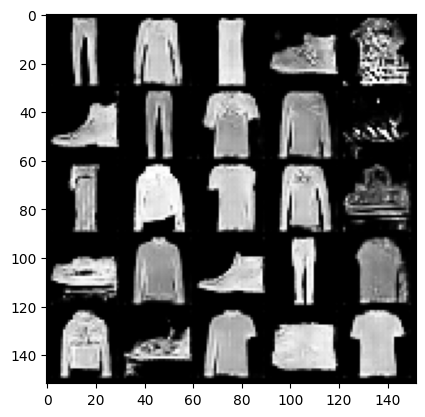

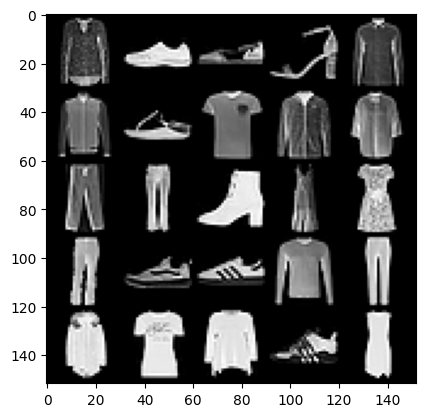

 11%|████████▋                                                                       | 102/938 [00:00<00:05, 163.79it/s]

Epoch 34, step 32000: Generator loss: 2.0542246508598336, discriminator loss: 0.39020562323927854


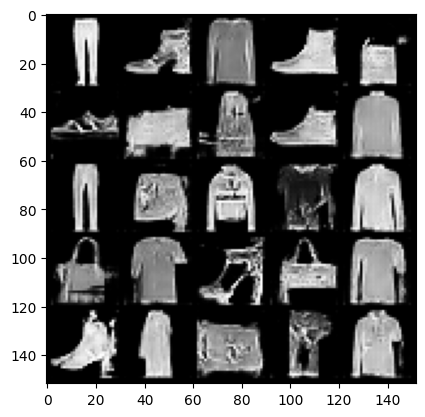

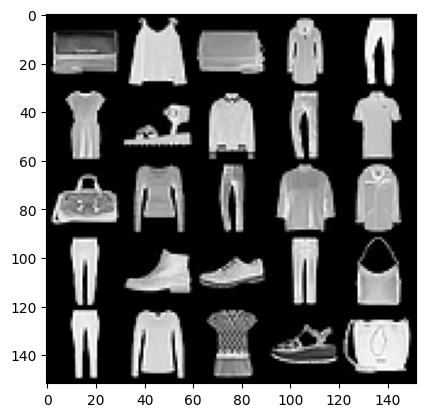

 63%|██████████████████████████████████████████████████▋                             | 595/938 [00:03<00:02, 162.50it/s]

Epoch 34, step 32500: Generator loss: 2.0284840186834345, discriminator loss: 0.3942042866349218


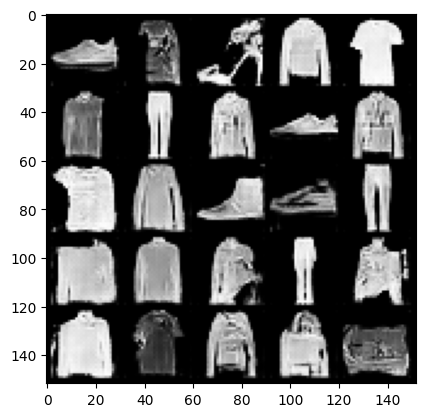

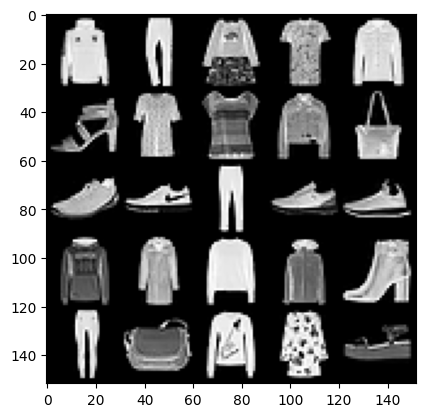

 17%|█████████████▏                                                                  | 155/938 [00:00<00:04, 162.18it/s]

Epoch 35, step 33000: Generator loss: 2.0684781208038334, discriminator loss: 0.40297680780291506


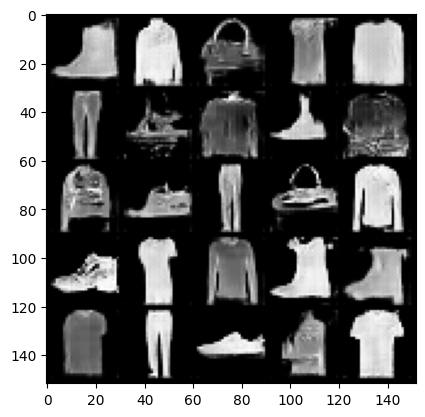

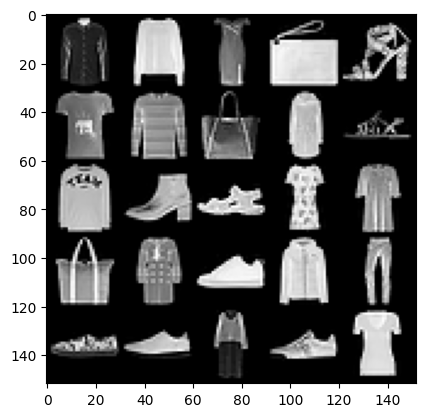

 71%|████████████████████████████████████████████████████████▋                       | 665/938 [00:04<00:01, 155.53it/s]

Epoch 35, step 33500: Generator loss: 2.0138380064964294, discriminator loss: 0.384380519017577


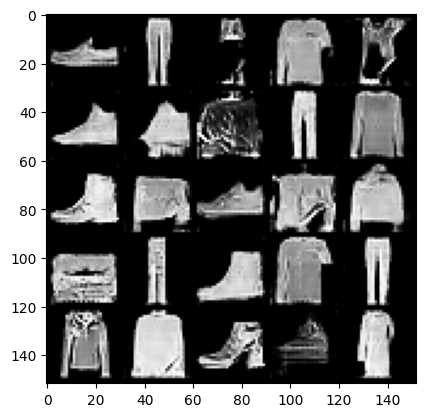

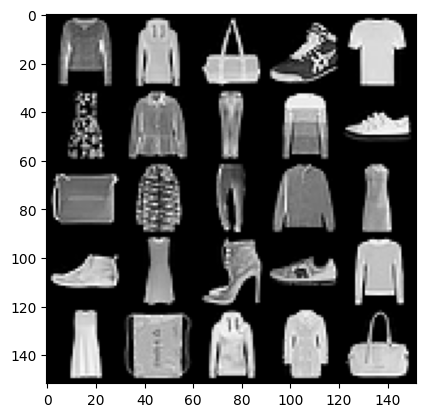

 23%|██████████████████▊                                                             | 220/938 [00:01<00:05, 136.01it/s]

Epoch 36, step 34000: Generator loss: 2.0346407880783084, discriminator loss: 0.4023167783319948


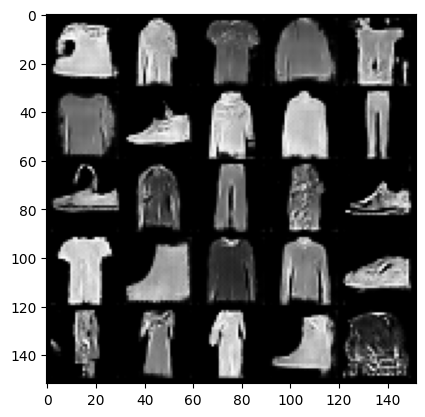

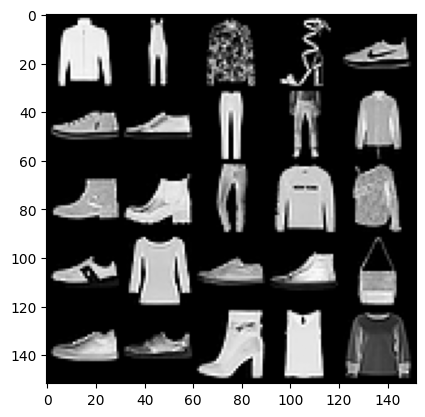

 78%|██████████████████████████████████████████████████████████████▎                 | 730/938 [00:04<00:01, 161.21it/s]

Epoch 36, step 34500: Generator loss: 2.052308721899985, discriminator loss: 0.39727922114729874


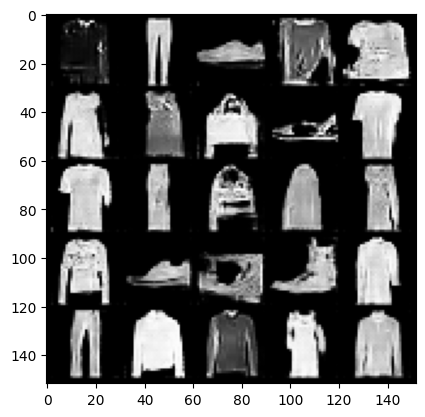

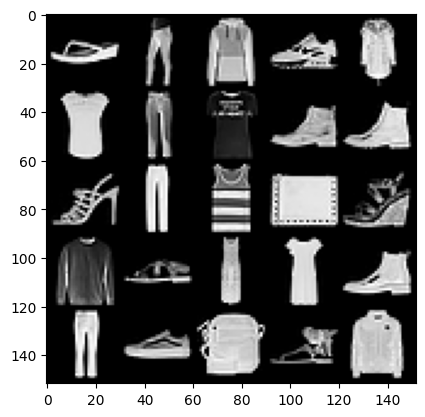

 31%|████████████████████████▍                                                       | 287/938 [00:01<00:03, 164.60it/s]

Epoch 37, step 35000: Generator loss: 2.0301929165124886, discriminator loss: 0.3899572559595112


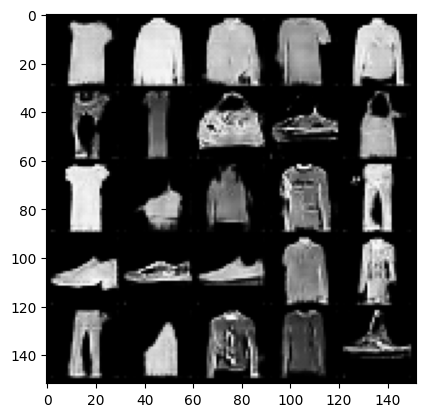

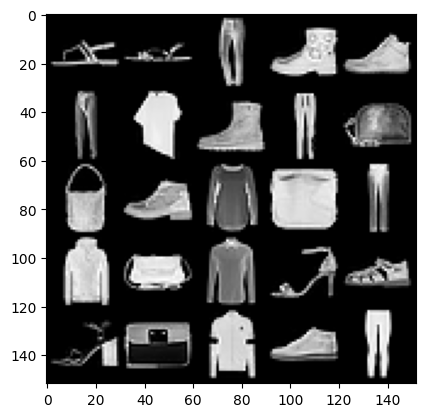

 83%|██████████████████████████████████████████████████████████████████▋             | 782/938 [00:04<00:00, 169.51it/s]

Epoch 37, step 35500: Generator loss: 2.0518014756441127, discriminator loss: 0.3966601089239122


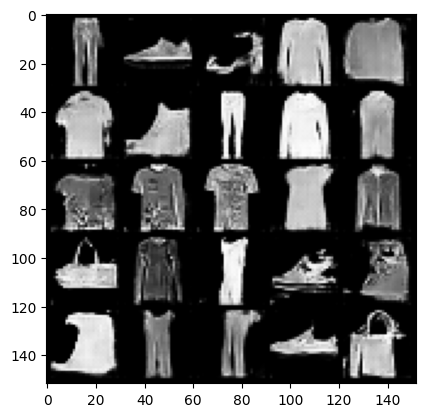

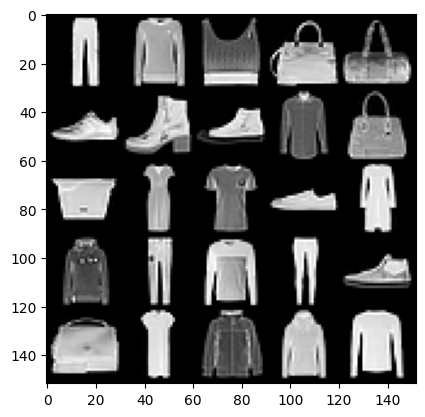

 37%|█████████████████████████████▊                                                  | 350/938 [00:02<00:03, 161.73it/s]

Epoch 38, step 36000: Generator loss: 2.0563418564796474, discriminator loss: 0.3831598841845989


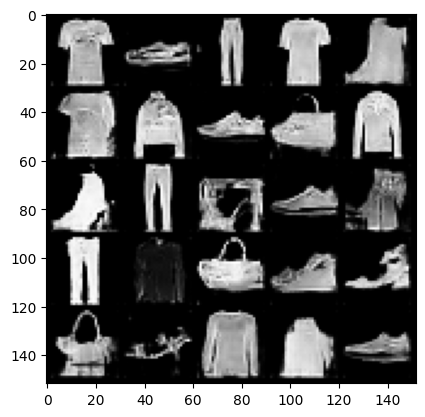

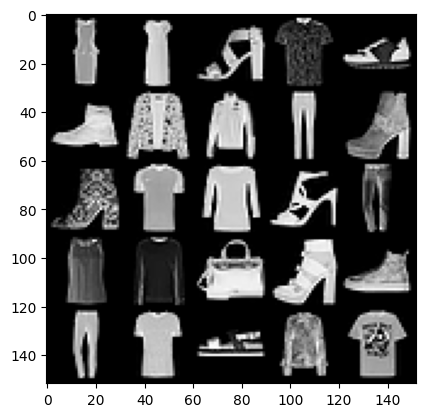

 90%|████████████████████████████████████████████████████████████████████████▏       | 847/938 [00:05<00:00, 166.05it/s]

Epoch 38, step 36500: Generator loss: 2.0617683041095707, discriminator loss: 0.38740566948056215


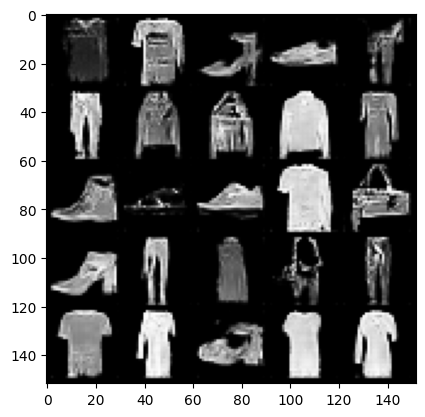

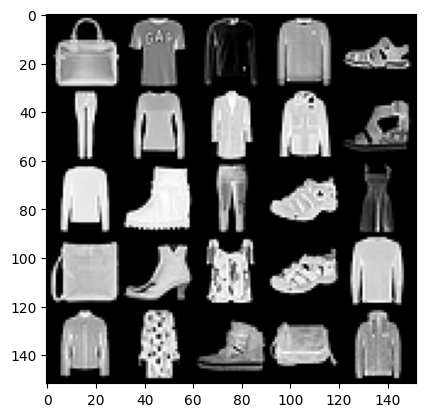

 44%|███████████████████████████████████▎                                            | 414/938 [00:02<00:03, 157.54it/s]

Epoch 39, step 37000: Generator loss: 2.1394838542938226, discriminator loss: 0.40715979537367797


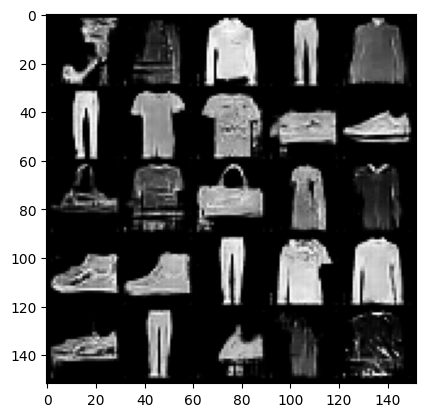

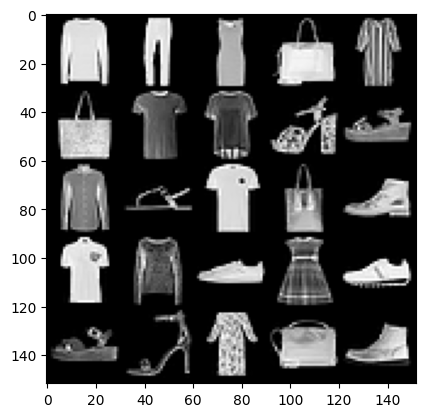

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 909/938 [00:06<00:00, 155.29it/s]

Epoch 39, step 37500: Generator loss: 2.081645389556888, discriminator loss: 0.3898604611754415


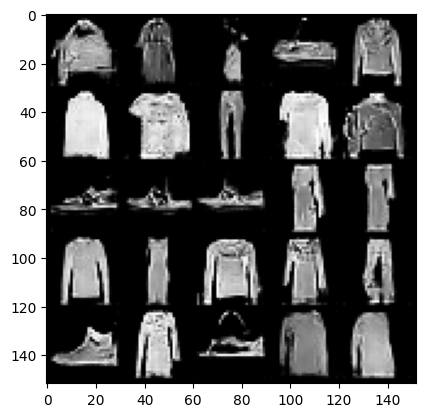

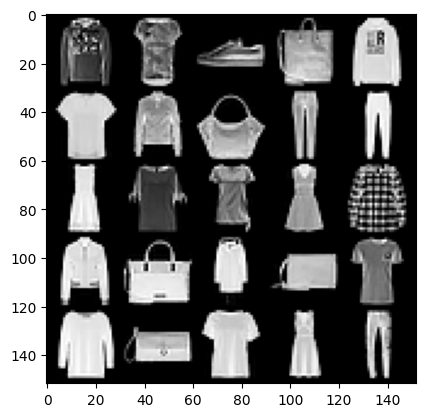

 51%|████████████████████████████████████████▉                                       | 480/938 [00:03<00:02, 153.23it/s]

Epoch 40, step 38000: Generator loss: 2.092562311768531, discriminator loss: 0.3695253170728683


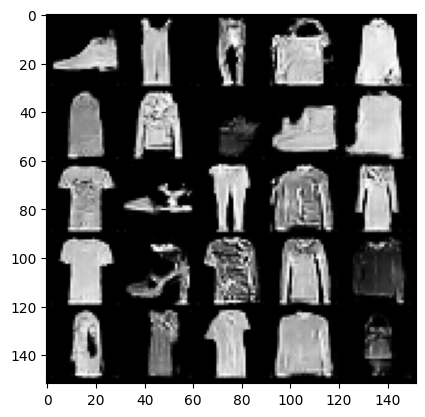

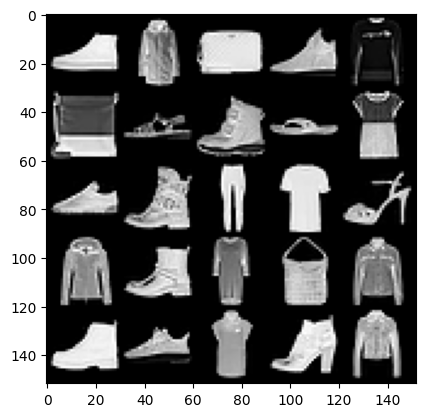

  4%|███                                                                              | 35/938 [00:00<00:05, 171.70it/s]

Epoch 41, step 38500: Generator loss: 2.0749171333312972, discriminator loss: 0.39552861517667803


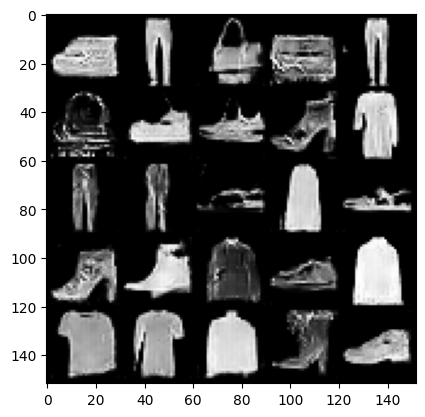

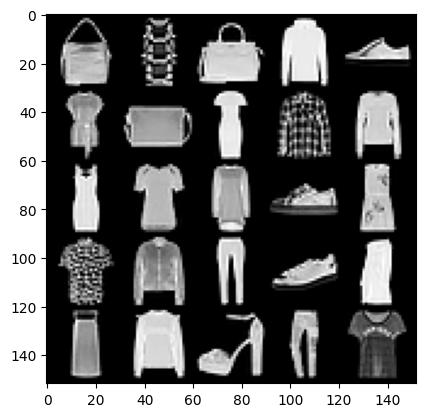

 57%|█████████████████████████████████████████████▌                                  | 534/938 [00:03<00:02, 167.76it/s]

Epoch 41, step 39000: Generator loss: 2.096776983737945, discriminator loss: 0.39216007801890357


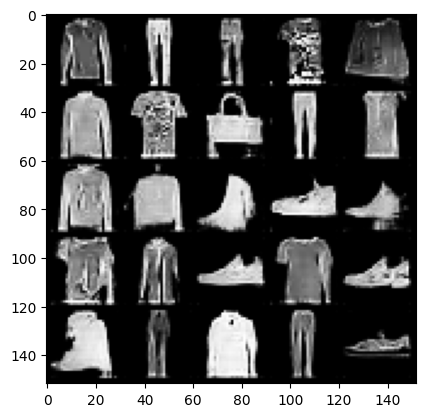

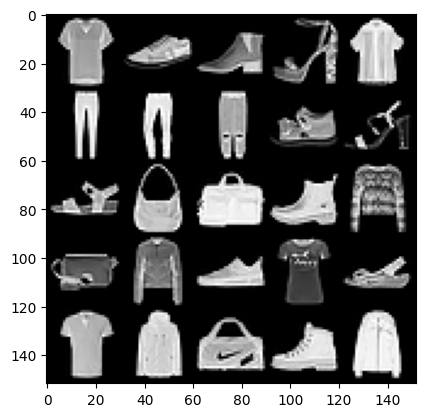

  9%|███████▋                                                                         | 89/938 [00:00<00:04, 170.04it/s]

Epoch 42, step 39500: Generator loss: 2.070243872880935, discriminator loss: 0.3907185726314784


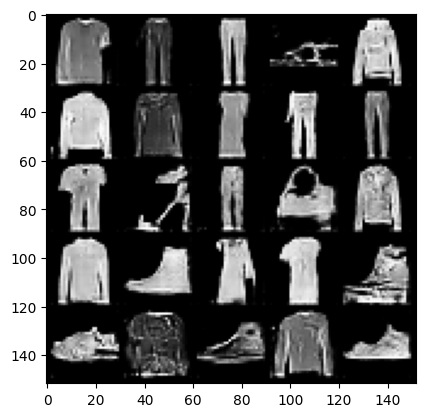

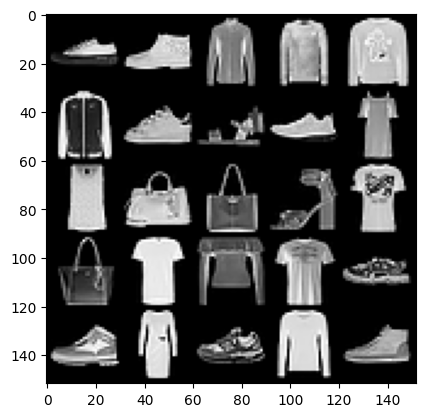

 63%|██████████████████████████████████████████████████▎                             | 590/938 [00:03<00:02, 162.85it/s]

Epoch 42, step 40000: Generator loss: 2.0900561603307732, discriminator loss: 0.3984632628262046


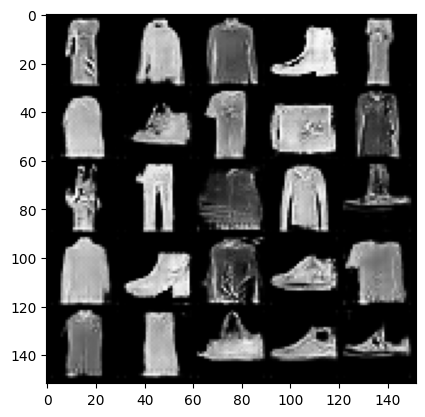

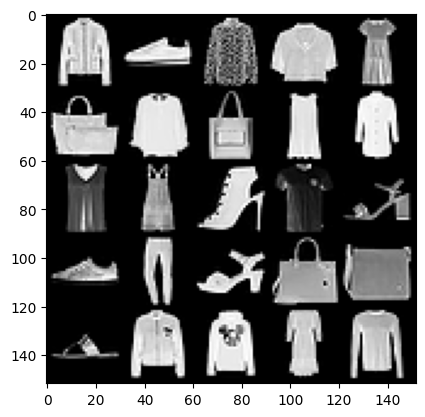

 16%|█████████████                                                                   | 153/938 [00:00<00:04, 162.37it/s]

Epoch 43, step 40500: Generator loss: 2.0752822660207753, discriminator loss: 0.3987209819555284


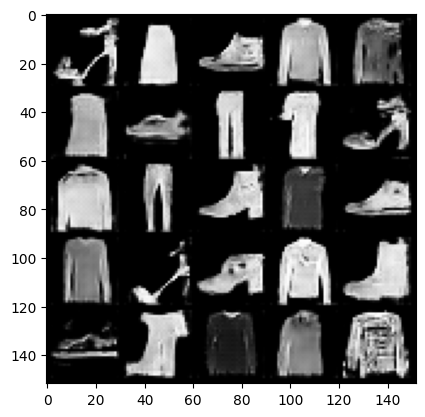

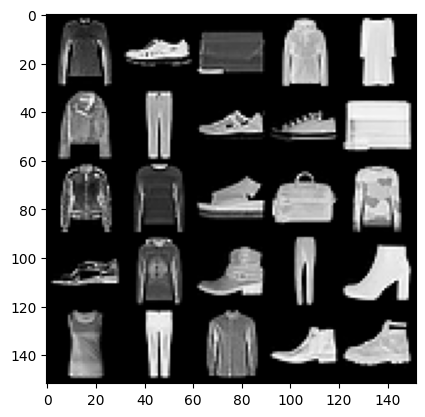

 70%|███████████████████████████████████████████████████████▌                        | 652/938 [00:04<00:01, 162.29it/s]

Epoch 43, step 41000: Generator loss: 2.0448995518684385, discriminator loss: 0.3793462635874751


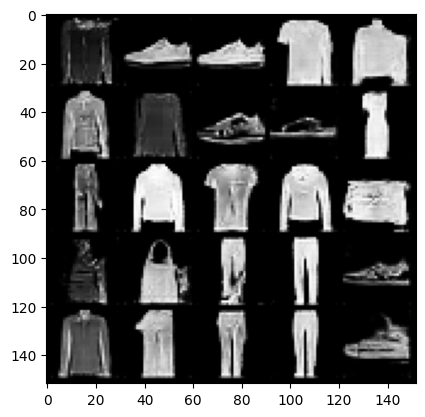

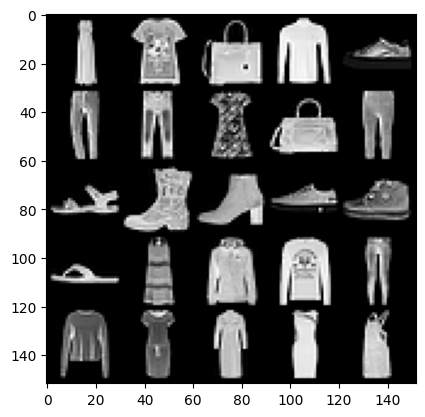

 24%|███████████████████▍                                                            | 228/938 [00:01<00:04, 152.74it/s]

Epoch 44, step 41500: Generator loss: 2.018214013338088, discriminator loss: 0.37984849441051505


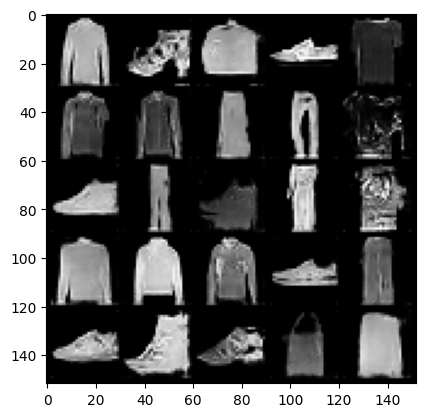

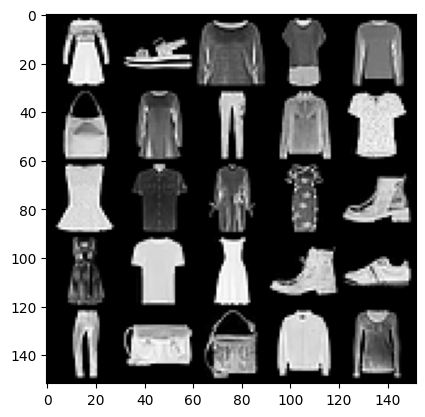

 77%|█████████████████████████████████████████████████████████████▏                  | 718/938 [00:04<00:01, 168.48it/s]

Epoch 44, step 42000: Generator loss: 2.153506731271744, discriminator loss: 0.3884053303003311


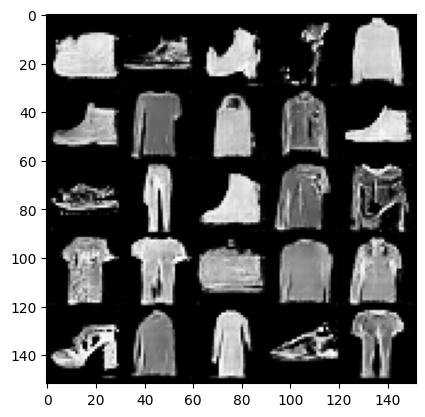

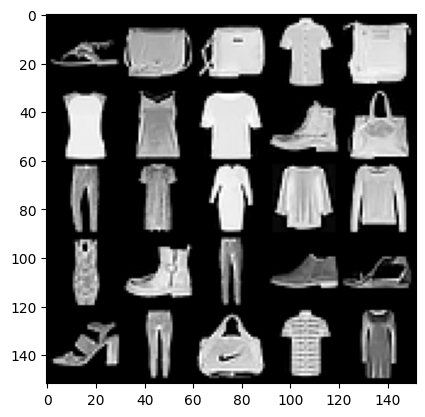

 30%|████████████████████████                                                        | 282/938 [00:01<00:03, 165.74it/s]

Epoch 45, step 42500: Generator loss: 2.078430271983149, discriminator loss: 0.3875392421782017


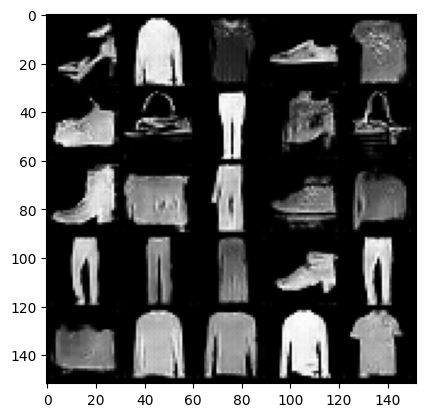

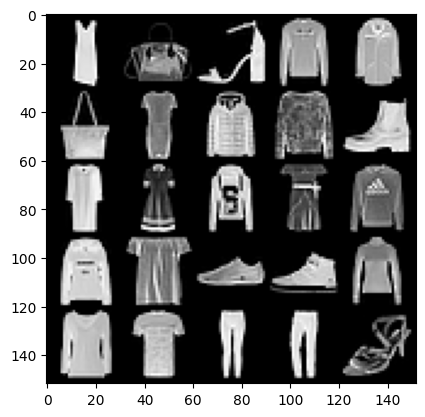

 83%|██████████████████████████████████████████████████████████████████▋             | 782/938 [00:04<00:00, 169.36it/s]

Epoch 45, step 43000: Generator loss: 2.0808168559074414, discriminator loss: 0.39707637155055986


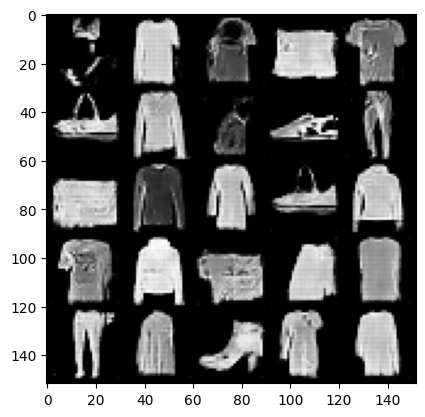

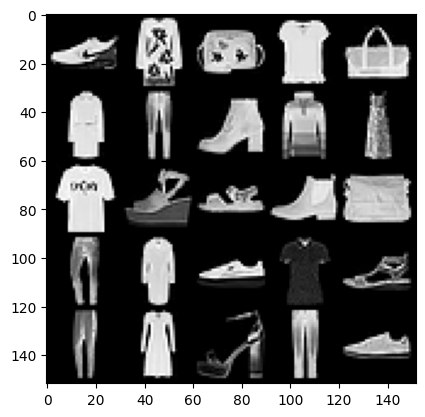

 36%|████████████████████████████▉                                                   | 340/938 [00:02<00:03, 158.70it/s]

Epoch 46, step 43500: Generator loss: 2.165824264287948, discriminator loss: 0.38353850406408313


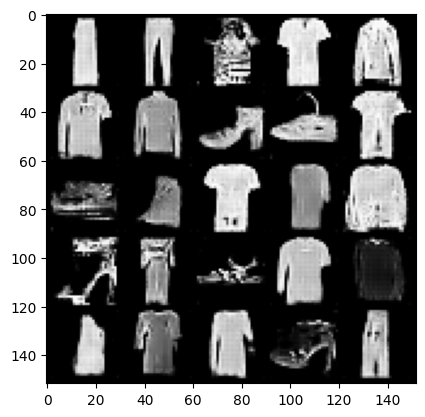

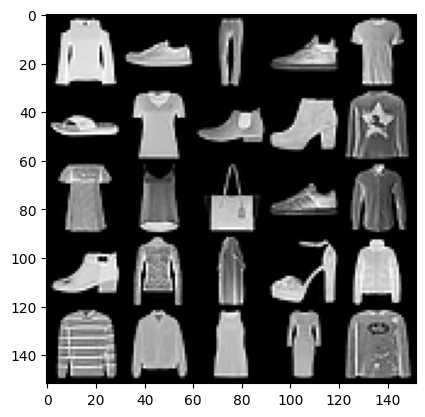

 89%|███████████████████████████████████████████████████████████████████████▍        | 838/938 [00:05<00:00, 165.13it/s]

Epoch 46, step 44000: Generator loss: 2.108828320741652, discriminator loss: 0.39563928946852706


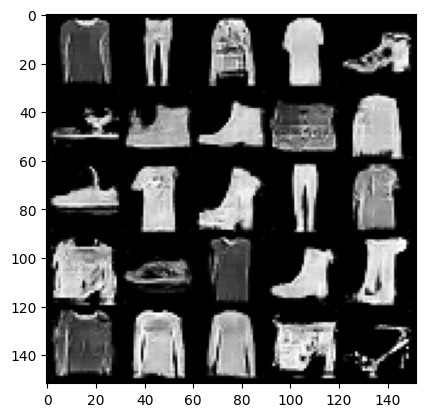

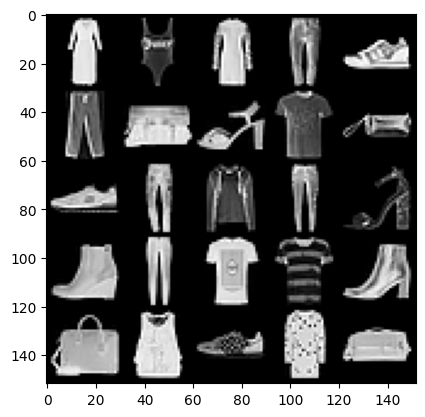

 44%|██████████████████████████████████▉                                             | 410/938 [00:02<00:03, 148.19it/s]

Epoch 47, step 44500: Generator loss: 2.140476635694504, discriminator loss: 0.38144495210051516


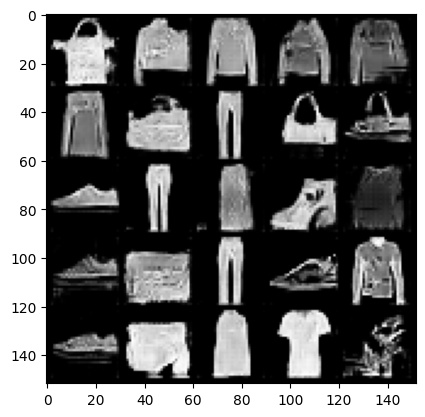

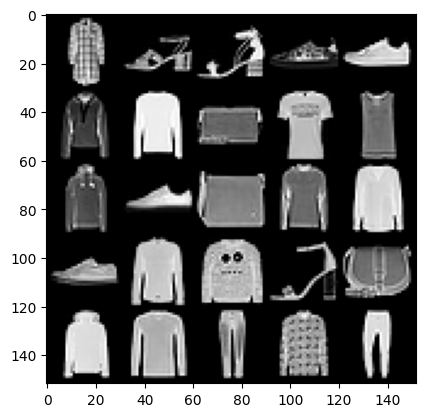

 97%|█████████████████████████████████████████████████████████████████████████████▎  | 907/938 [00:06<00:00, 159.69it/s]

Epoch 47, step 45000: Generator loss: 2.049193172097206, discriminator loss: 0.3935114710330966


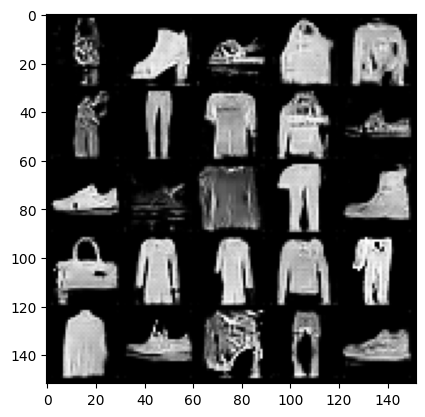

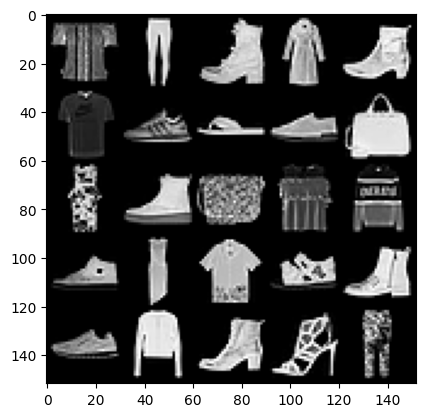

 49%|███████████████████████████████████████▌                                        | 464/938 [00:02<00:02, 168.88it/s]

Epoch 48, step 45500: Generator loss: 2.080522385716438, discriminator loss: 0.3854901255965233


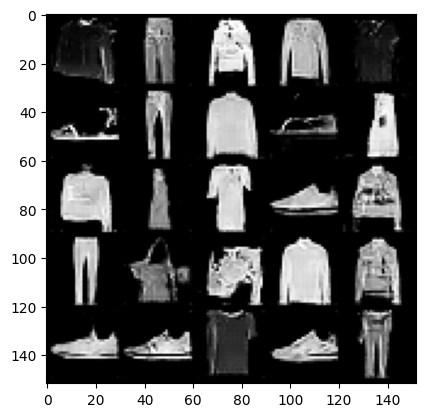

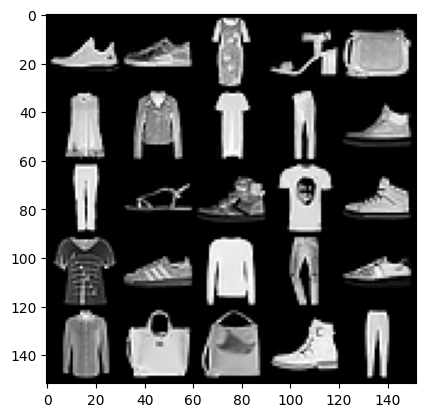

  4%|███                                                                              | 35/938 [00:00<00:05, 169.75it/s]

Epoch 49, step 46000: Generator loss: 2.130774206876757, discriminator loss: 0.3840781891047955


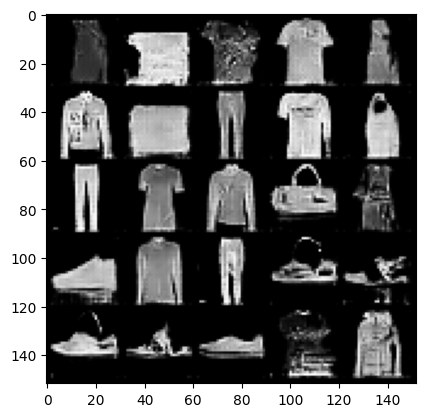

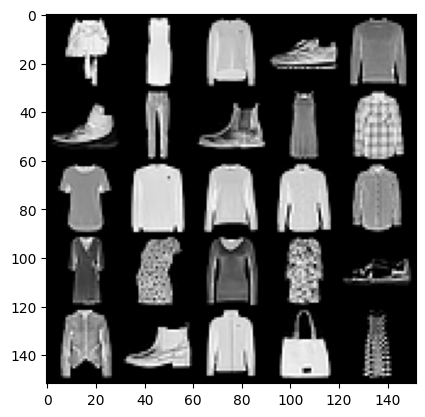

 57%|█████████████████████████████████████████████▍                                  | 533/938 [00:03<00:02, 170.81it/s]

Epoch 49, step 46500: Generator loss: 2.0802245496511453, discriminator loss: 0.38645994706451936


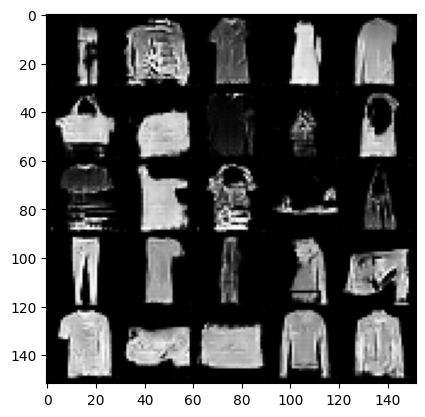

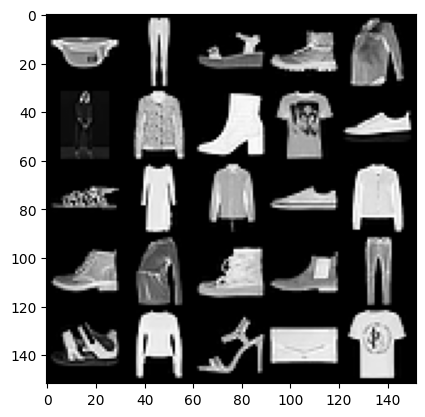

100%|████████████████████████████████████████████████████████████████████████████████| 938/938 [00:06<00:00, 154.52it/s]


In [367]:
n_epochs = 50
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
train_gan(n_epochs,cur_step,mean_generator_loss,mean_discriminator_loss,gen,gen_opt,disc,disc_opt,dataloader,criterion,z_dim,display_step,device)
# for epoch in range(n_epochs):
#         # Dataloader returns the batches
#         for real, _ in tqdm(dataloader):
#             cur_batch_size = len(real)
#             real = real.to(device)
    
#             ## Update discriminator ##
#             disc_opt.zero_grad()
#             fake_noise = get_noise(cur_batch_size, z_dim, device=device)
#             fake = gen(fake_noise)
#             disc_fake_pred = disc(fake.detach())
#             disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
#             disc_real_pred = disc(real)
#             disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
#             disc_loss = (disc_fake_loss + disc_real_loss) / 2
    
#             # Keep track of the average discriminator loss
#             mean_discriminator_loss += disc_loss.item() / display_step
#             # Update gradients
#             disc_loss.backward(retain_graph=True)
#             # Update optimizer
#             disc_opt.step()
    
#             ## Update generator ##
#             gen_opt.zero_grad()
#             fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
#             fake_2 = gen(fake_noise_2)
#             disc_fake_pred = disc(fake_2)
#             gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
#             gen_loss.backward()
#             gen_opt.step()
    
#             # Keep track of the average generator loss
#             mean_generator_loss += gen_loss.item() / display_step
    
#             ## Visualization code ##
#             if cur_step % display_step == 0 and cur_step > 0:
#                 print(f"Epoch {epoch}, step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
#                 show_tensor_images(fake)
#                 show_tensor_images(real)
#                 mean_generator_loss = 0
#                 mean_discriminator_loss = 0
#             cur_step += 1


## Task 9: Generate Synthetic Images with DCGAN

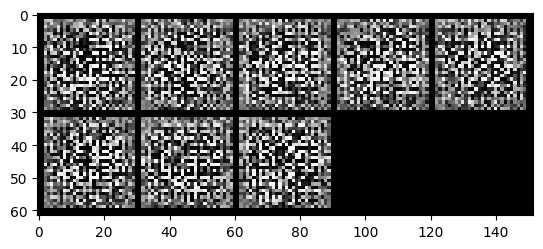

In [368]:
# noise=tf.random.normal(shape=[batch_size,num_features])
# generated_images=generator(noise)
# plot_utils.show(generated_images,8)
gen = Generator()
test_gen_noise = get_noise(batch_size, gen.z_dim)
test_uns_gen_noise = gen.unsqueeze_noise(test_gen_noise)
generated_image=gen(test_uns_gen_noise)
show_tensor_images(generated_image,8)


/tmp/ipykernel_1376/3922077182.py:18: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
/tmp/ipykernel_1376/3922077182.py:20: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


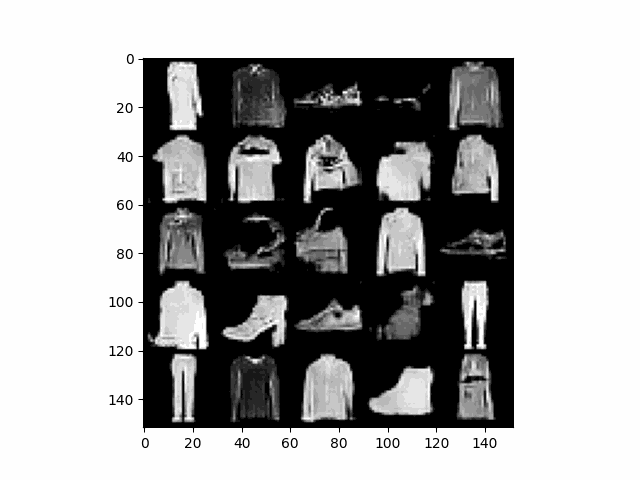

In [369]:
## Source: https://www.tensorflow.org/tutorials/generative/dcgan#create_a_gif

import imageio
import glob

anim_file = 'dcgan2.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    last = -1
    for i,filename in enumerate(filenames):
        frame = 2*(i**0.5)
        if round(frame) > round(last):
            last = frame
        else:
            continue
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

import IPython
display.Image(filename=anim_file)